<a href="https://colab.research.google.com/github/freentour/AIFFEL_quest/blob/main/Exploration_quest/Quest01/1_2_flowers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# 구글 드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# 구글 드라이브 경로
# /content/drive/MyDrive/AIFFEL/data/tf_flowers/

# 1. VGG16 모델

## 1.1 데이터셋 로드

In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds

# 'tf_flowers' 데이터셋 다운로드 및 로드
(raw_train, raw_validation, raw_test), metadata = tfds.load(
    name='tf_flowers',    # tfds(텐서플로우 데이터셋) 이름
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    # data_dir='./data/tf_flowers/',   # 데이터셋 다운로드 받아 저장할 위치. 이미 다운로드 받은 경우에는 저장되어 있는 위치.
    data_dir='/content/drive/MyDrive/AIFFEL/data/tf_flowers/',   # 데이터셋 다운로드 받아 저장할 위치. 이미 다운로드 받은 경우에는 저장되어 있는 위치.
    download=False,   # 이미 다운로드 받아둔 것이 있어서 다시 다운로드 받지 않아도 되는 경우
    # shuffle_files=True,   # tfds로 맨 처음 데이터를 '로드하는 시점에' 데이터를 섞어서 로드할 것인지 여부를 설정하는 옵션
    with_info=True,   # 데이터셋에 대한 다양한 메타데이터 포함 여부를 설정하는 옵션
    as_supervised=True,   # 데이터셋을 로드할 때 데이터가 (input, label) 쌍의 형태로 반환되도록 설정하는 옵션
)

## 1.2 메타데이터 및 데이터셋 기본 정보 확인

In [2]:
metadata

tfds.core.DatasetInfo(
    name='tf_flowers',
    full_name='tf_flowers/3.0.1',
    description="""
    A large set of images of flowers
    """,
    homepage='https://www.tensorflow.org/tutorials/load_data/images',
    data_dir='/content/drive/MyDrive/AIFFEL/data/tf_flowers/tf_flowers/3.0.1',
    file_format=tfrecord,
    download_size=218.21 MiB,
    dataset_size=221.83 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=5),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=3670, num_shards=2>,
    },
    citation="""@ONLINE {tfflowers,
    author = "The TensorFlow Team",
    title = "Flowers",
    month = "jan",
    year = "2019",
    url = "http://download.tensorflow.org/example_images/flower_photos.tgz" }""",
)

In [3]:
# features 관련 정보 확인
print(metadata.features)
print(metadata.features['image'])
print(metadata.features['label'])
print(metadata.features['image'].shape)
print(metadata.features['label'].shape)
print(metadata.features['label'].num_classes)

FeaturesDict({
    'image': Image(shape=(None, None, 3), dtype=uint8),
    'label': ClassLabel(shape=(), dtype=int64, num_classes=5),
})
Image(shape=(None, None, 3), dtype=uint8)
ClassLabel(shape=(), dtype=int64, num_classes=5)
(None, None, 3)
()
5


In [4]:
# splits 관련 정보 확인
print(metadata.splits['train'])
print(metadata.splits['train'].num_examples)   # 전체 샘플 수
# sharding(분할): 데이터셋이 너무 크거나 메모리에 한 번에 적재하기 어려운 경우, sharding을 통해 데이터셋을 작은 단위로 나누어 처리.
# 각 shard를 독립적으로 읽고(병렬 처리) 병합하여 전체 데이터셋을 구성
print(metadata.splits['train'].num_shards)

<SplitInfo num_examples=3670, num_shards=2>
3670
2


In [5]:
# 데이터셋 갯수 확인
print(len(raw_train), len(raw_validation), len(raw_test))
print(len(raw_train) + len(raw_validation) + len(raw_test))

2936 367 367
3670


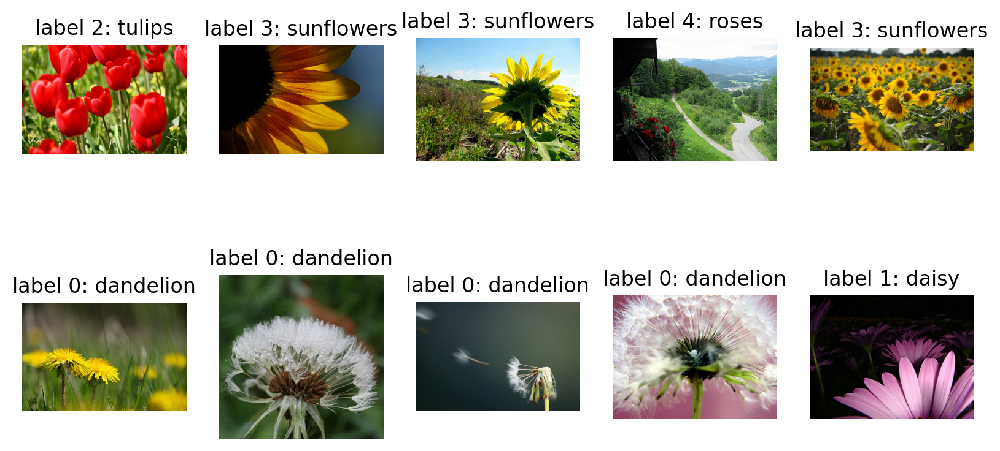

In [6]:
# 10개의 샘플 데이터만 표시해 보기: 이미지 사이즈가 제각각임을 알 수 있음!
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str   # int2str: 정수형 레이블을 문자열 레이블로 변환

for idx, (image, label) in enumerate(raw_train.take(10)):  # 10개의 데이터를 가져 옵니다.
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

## 1.3 데이터 전처리

In [7]:
# 사전 학습 모델별 전처리 함수 import
# [참고] https://www.tensorflow.org/api_docs/python/tf/keras/applications
from tensorflow.keras.applications.vgg16 import preprocess_input as vgg16_preprocess_input
from tensorflow.keras.applications.mobilenet import preprocess_input as mobilenet_preprocess_input
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as mobilenet_v2_preprocess_input
from tensorflow.keras.applications.mobilenet_v3 import preprocess_input as mobilenet_v3_preprocess_input

In [8]:
# 데이터 전처리를 위한 공통 함수(재사용하기 위해 정의)
def full_preprocess_data(model_name='', img_size=224, batch_size=32):
    # [중요] 리사이징할 이미지의 크기 설정: 사전 학습 모델의 경우, 모델마다 입력 이미지의 크기가 지정되어 있는 경우가 많음.
    IMG_SIZE = img_size    # 각 사전 학습 모델에서 요구하는 이미지 크기

    # # 타입 캐스팅, 스케일 변환, 리사이즈를 한꺼번에 처리하는 사용자 정의 함수
    # # 일반적으로 각 사전 학습 모델별로 정의되어 있는 preprocess_input() 함수에서 처리하는 것과 거의 유사한 처리를 하고 있음.
    # # 참고로, preprocess_input() 함수에서는 일반적으로 타입 캐스팅, 스케일 변환, 정규화(평균을 빼고 표준편차로 나누는), 채널 순서 변경(RGB를 BGR 순서로) 등의 처리를 함. (하지만, 각 모델별로 처리 방식이 조금씩 다름!!)
    # def preprocess_data(image, label):
    #     image = tf.cast(image, tf.float32)    # image=float(image)같은 타입캐스팅의  텐서플로우 버전입니다.
    #     image = (image/127.5) - 1   # 픽셀값의 scale 수정: -1 부터 1까지의 범위로 스케일 변환
    #     image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    #     return image, label

    # 타입 캐스팅, 스케일 변환만 처리하는 사용자 정의 함수
    def default_preprocess_input(image):
        image = tf.cast(image, tf.float32)    # image=float(image)같은 타입캐스팅의  텐서플로우 버전입니다.
        image = (image/127.5) - 1   # 픽셀값의 scale 수정: -1 부터 1까지의 범위로 스케일 변환
        return image

    # 사전 학습 모델이 아닌 경우에는 앞의 함수처럼 직접 함수 정의해서 사용하는 것이 표준.
    # 사전 학습 모델인 경우에는 각 사전 학습 모델마다 각각 정의되어 있는 preprocess_input() 함수를 사용하는 것이 더 좋음.
    # 타입 캐스팅, 데이터 스케일링, 정규화, 채널 순서 변경 등의 처리를 사전 학습 모델이 학습할 때의 방식과 동일하게 맞춰서 전처리를 해 줌.
    # 이렇게 하면 입력 데이터셋에 대해 학습도 더 잘 이루어지고, 학습 후의 정확도 역시 개선된다고 함.
    # 단, 이미지 리사이즈는 처리하지 않으므로 별도로 처리해 주어야 함.
    # 따라서, 사전 학습 모델을 사용하는 경우에는 전처리 함수를 다음과 같이 작성해서 사용하는 것이 표준.
    # preprocess_input() 함수를 사용하는 경우의 유일한 단점은 전처리된 후의 결과를 plt.imshow 메소드를 통해 화면에 표시하고 싶은 경우에 복잡한 문제가 생김.
    # 즉, 화면에 표시하려면 전처리 작업의 정반대 작업을 통해 복원시켜야 하는데, 전처리 방식이 각 사전 학습 모델별로 조금씩 다르기 때문에 일괄로 처리하기가 어려움.
    # 그래서, 전처리 후의 결과를 화면에 표시해야 하는 경우에는 preprocess_input() 함수 사용하지 않고, 앞에서처럼 직접 정의해서 사용하는 것을 선호하기도 함.
    # 물론, 배우는 과정에서나 전처리된 후의 결과를 화면에 표시하면서 확인하려고 하지 대부분의 상황에서는 화면에 표시할 일 없으므로, preprocess_input() 함수 이용해서 전처리 하는 것이 가장 효과적이고 강추하는 방식임!

    # 데이터셋 전처리 함수 - preprocess_input 이용하는 버전
    def preprocess_data(image, label):
        image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))

        # 각 모델별로 사전 학습 당시의 방식 그대로 타입 캐스팅, 스케일링, 정규화, 채널 순서 변경 등을 처리함.
        # (모델별로 구체적인 처리 방식은 조금씩 다름)
        if model_name == 'vgg16':
            image = vgg16_preprocess_input(image)
        elif model_name == 'mobilenet':
            image = mobilenet_preprocess_input(image)
        elif model_name == 'mobilenet_v2':
            image = mobilenet_v2_preprocess_input(image)
        elif model_name == 'mobilenet_v3':
            image = mobilenet_v3_preprocess_input(image)
        # efficientnet_v2 모델의 경우, 기본적으로 Scaling 레이어가 모델의 일부로 포함되기 때문에
        # preprocess_input 함수는 실제로 처리하는 것이 없이 그냥 바이패스한다고 함.
        # 대신 모델에서는 0~255 범위의 '부동소수점' 형식의 입력 텐서를 기대하기 때문에 아래의 코드처럼 직접 타입캐스팅 처리해 주어야 함.
        # 참고로, 모델 생성자에서 include_preprocessing=False로 지정되는 경우에는 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하기 때문에
        # default_preprocess_input 함수 호출해주면 됨. (기본값은 include_preprocessing=True 임)
        elif model_name == 'efficientnet_v2':
            image = tf.cast(image, tf.float32)    # 정수형을 부동소수점 형식으로 타입캐스팅 처리만 하면 됨.
            # image = default_preprocess_input(image)   # EfficientNetV2 모델 생성 시 include_preprocessing=False로 지정되는 경우의 전처리 방법
        else:
            image = default_preprocess_input(image)

        return image, label

    # map 함수를 이용해 모든 이미지를 한 번에 전처리
    train = raw_train.map(preprocess_data)
    validation = raw_validation.map(preprocess_data)
    test = raw_test.map(preprocess_data)

    print(train)
    print(validation)
    print(test)

    # 전처리 작업이 잘 이루어졌는지 10개의 샘플 이미지 화면에 다시 표시해 보기
    # [참고] preprocess_input() 함수를 통해 전처리한 경우에는 각 픽셀 값이 스케일 변환, 정규화 과정을 거친 값을 가지고 있어서 정상적인 컬러로 표시될 수 없음.
    # 모든 이미지 파일의 사이즈가 동일해진 것을 확인할 수 있음!
    plt.figure(figsize=(10, 5))

    get_label_name = metadata.features['label'].int2str

    for idx, (image, label) in enumerate(train.take(10)):
        plt.subplot(2, 5, idx+1)
        image = (image + 1) / 2   # -1 부터 1 사이의 값으로 스케일 변환했던 것을 다시 0 부터 1 사이의 값으로 변환. (음수값은 화면에 표시할 수 없기 때문)
        plt.imshow(image)   # [참고] 이미지 파일의 픽셀 값이 0~255 사이가 아닌 0~1 사이의 실수값이어도 imshow 메소드는 자동으로 값을 0~255 사이의 값으로 변환해 화면에 표시해 줌.
        plt.title(f'label {label}: {get_label_name(label)}')
        plt.axis('off')

    # 데이터셋을 배치 크기로 준비
    BATCH_SIZE = batch_size
    SHUFFLE_BUFFER_SIZE = 1000    # 셔플용 버퍼 사이즈

    # train 데이터만 shuffle하고 나머지 validation, test 데이터는 shuffle 하지 않음!
    train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
    validation_batches = validation.batch(BATCH_SIZE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
    test_batches = test.batch(BATCH_SIZE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)

    # 배치 단위로 잘 준비되었는지 확인
    for image_batch, label_batch in train_batches.take(1):
        break

    print(f"image batch's shape: {image_batch.shape}, label batch's shape: {label_batch.shape}")

    return train_batches, validation_batches, test_batches

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


image batch's shape: (32, 224, 224, 3), label batch's shape: (32,)


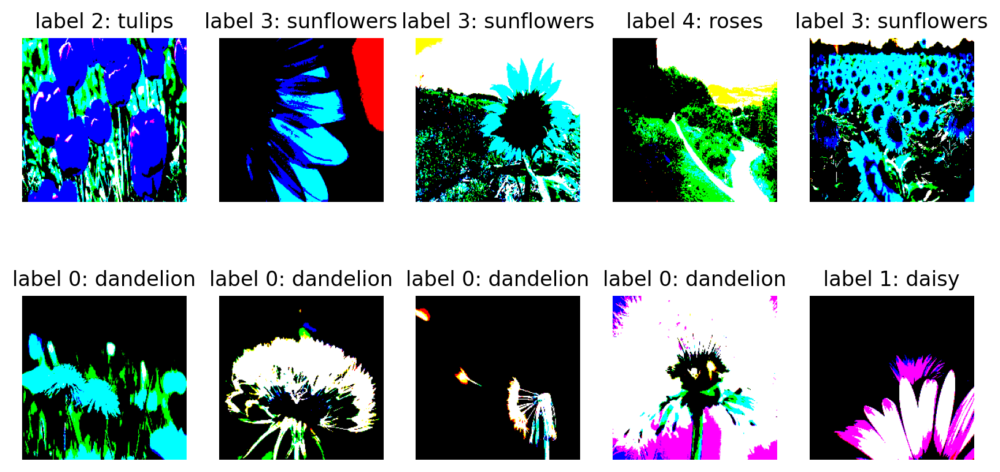

In [9]:
# VGG16 모델용 데이터 전처리
model_name = 'vgg16'
img_size = 224
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

In [ ]:
# [중요] 리사이징할 이미지의 크기 설정: 사전 학습 모델의 경우, 모델마다 입력 이미지의 크기가 지정되어 있는 경우가 많음.
IMG_SIZE = 224    # VGG16 모델에서 요구하는 이미지 크기

# # 타입 캐스팅, 스케일 변환, 리사이즈를 한꺼번에 처리하는 사용자 정의 함수
# # 일반적으로 각 사전 학습 모델별로 정의되어 있는 preprocess_input() 함수에서 처리하는 것과 거의 유사한 처리를 하고 있음.
# # 참고로, preprocess_input() 함수에서는 일반적으로 타입 캐스팅, 스케일 변환, 정규화(평균을 빼고 표준편차로 나누는), 채널 순서 변경(RGB를 BGR 순서로) 등의 처리를 함. (하지만, 각 모델별로 처리 방식이 조금씩 다름!!)
# def preprocess_data(image, label):
#     image = tf.cast(image, tf.float32)    # image=float(image)같은 타입캐스팅의  텐서플로우 버전입니다.
#     image = (image/127.5) - 1   # 픽셀값의 scale 수정: -1 부터 1까지의 범위로 스케일 변환
#     image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
#     return image, label

# 사전 학습 모델이 아닌 경우에는 앞의 함수처럼 직접 함수 정의해서 사용하는 것이 표준.
# 사전 학습 모델인 경우에는 각 사전 학습 모델마다 각각 정의되어 있는 preprocess_input() 함수를 사용하는 것이 더 좋음.
# 타입 캐스팅, 데이터 스케일링, 정규화, 채널 순서 변경 등의 처리를 사전 학습 모델이 학습할 때의 방식과 동일하게 맞춰서 전처리를 해 줌.
# 이렇게 하면 입력 데이터셋에 대해 학습도 더 잘 이루어지고, 학습 후의 정확도 역시 개선된다고 함.
# 단, 이미지 리사이즈는 처리하지 않으므로 별도로 처리해 주어야 함.
# 따라서, 사전 학습 모델을 사용하는 경우에는 전처리 함수를 다음과 같이 작성해서 사용하는 것이 표준.
# preprocess_input() 함수를 사용하는 경우의 유일한 단점은 전처리된 후의 결과를 plt.imshow 메소드를 통해 화면에 표시하고 싶은 경우에 복잡한 문제가 생김.
# 즉, 화면에 표시하려면 전처리 작업의 정반대 작업을 통해 복원시켜야 하는데, 전처리 방식이 각 사전 학습 모델별로 조금씩 다르기 때문에 일괄로 처리하기가 어려움.
# 그래서, 전처리 후의 결과를 화면에 표시해야 하는 경우에는 preprocess_input() 함수 사용하지 않고, 앞에서처럼 직접 정의해서 사용하는 것을 선호하기도 함.
# 물론, 배우는 과정에서나 전처리된 후의 결과를 화면에 표시하면서 확인하려고 하지 대부분의 상황에서는 화면에 표시할 일 없으므로, preprocess_input() 함수 이용해서 전처리 하는 것이 가장 효과적이고 강추하는 방식임!
from tensorflow.keras.applications.vgg16 import preprocess_input

# 데이터셋 전처리 함수 - preprocess_input 이용하는 버전
def preprocess_data(image, label):
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    image = preprocess_input(image)   # 사전 학습 당시의 방식 그대로 스케일링, 정규화, 채널 순서 변경 등을 처리함.
    return image, label

In [ ]:
# map 함수를 이용해 모든 이미지를 한 번에 전처리
train = raw_train.map(preprocess_data)
validation = raw_validation.map(preprocess_data)
test = raw_test.map(preprocess_data)

print(train)
print(validation)
print(test)

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


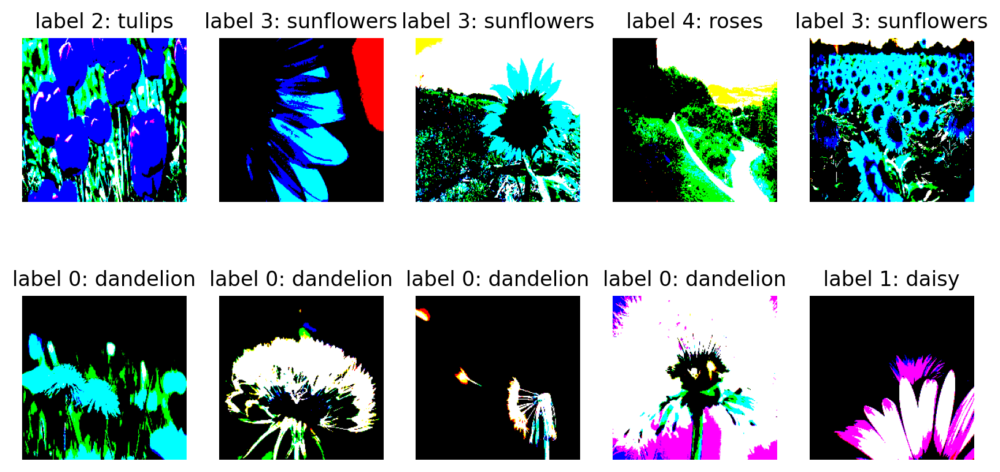

In [ ]:
# 전처리 작업이 잘 이루어졌는지 10개의 샘플 이미지 화면에 다시 표시해 보기
# [참고] preprocess_input() 함수를 통해 전처리한 경우에는 각 픽셀 값이 스케일 변환, 정규화 과정을 거친 값을 가지고 있어서 정상적인 컬러로 표시될 수 없음.
# 모든 이미지 파일의 사이즈가 동일해진 것을 확인할 수 있음!
plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(train.take(10)):
    plt.subplot(2, 5, idx+1)
    image = (image + 1) / 2   # -1 부터 1 사이의 값으로 스케일 변환했던 것을 다시 0 부터 1 사이의 값으로 변환. (음수값은 화면에 표시할 수 없기 때문)
    plt.imshow(image)   # [참고] 이미지 파일의 픽셀 값이 0~255 사이가 아닌 0~1 사이의 실수값이어도 imshow 메소드는 자동으로 값을 0~255 사이의 값으로 변환해 화면에 표시해 줌.
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [ ]:
# 데이터셋을 배치 크기로 준비
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000    # 셔플용 버퍼 사이즈

# train 데이터만 shuffle하고 나머지 validation, test 데이터는 shuffle 하지 않음!
train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
validation_batches = validation.batch(BATCH_SIZE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_batches = test.batch(BATCH_SIZE).cache().prefetch(buffer_size=tf.data.AUTOTUNE)

In [ ]:
# 배치 단위로 잘 준비되었는지 확인
for image_batch, label_batch in train_batches.take(1):
    break

print(f"image batch's shape: {image_batch.shape}, label batch's shape: {label_batch.shape}")

(TensorShape([32, 224, 224, 3]), TensorShape([32]))

## 1.4 모델 정의, 컴파일, 훈련

In [10]:
# 모델 구조를 그래프로 표시하기 위해 plot_model import
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, MaxPooling2D
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
import numpy as np

In [11]:
# 모델 정의, 컴파일, 훈련, 평가를 위한 공통 함수(재사용을 위해 정의)
def full_train_and_evaluate(model_name='', img_size=224, num_classes=5, learning_rate=0.0001):
    IMG_SIZE = img_size    # 각 모델별로 요구하는 이미지 크기
    IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
    NUM_CLASSES = num_classes   # 분류해야 할 클래스 갯수
    LEARNING_RATE = learning_rate   # 학습률

    if model_name == 'vgg16':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                                 include_top=False,   # 상단의 classifier 블록 미포함
                                                 weights='imagenet')
    elif model_name == 'mobilenet':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNet(input_shape=IMG_SHAPE,
                                                     include_top=False,   # 상단의 classifier 블록 미포함
                                                     # dropout=0.001,   # 드롭아웃 비율(기본값: 0.001)
                                                     weights='imagenet')
    elif model_name == 'mobilenet_v2':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                                       include_top=False,   # 상단의 classifier 블록 미포함
                                                       weights='imagenet')
    elif model_name == 'mobilenet_v3_large':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Large(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'mobilenet_v3_small':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Small(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'efficientnet_v2_l':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2L(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    elif model_name == 'efficientnet_v2_s':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2S(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    else:
        raise Exception("모르는 사전 학습 모델명입니다!")

    # 베이스 모델 구조 확인하기
    print("베이스 모델 구조 확인: ")
    base_model.summary()

    # 베이스 모델 구조를 그래프 형식으로 저장
    # model_grapth_full_path = './model_graph/' + model_name + '_base_model_plot.png'
    model_grapth_full_path = '/content/drive/MyDrive/AIFFEL/model_graph/' + model_name + '_base_model_plot.png'
    plot_model(base_model, to_file=model_grapth_full_path, show_shapes=True, show_layer_names=True)

    # 베이스 모델 블럭은 동결시키기. classifier 블럭만 학습 진행.
    base_model.trainable = False

    # 함수형 API 방식으로 classifier 포함한 최종 모델 구성
    # 모델의 입력 정의
    inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    # inputs = tf.keras.Input(shape=IMG_SHAPE)
    # [중요] training=False: base_model이 훈련 모드가 아닌 평가 모드로 동작하도록 설정!
    # (evaluate 실행 시 해당 모델에 있는 배치 정규화, 드롭아웃 등이 적용되지 않도록 보장함!!)
    x = base_model(inputs, training=False)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    # GlobalAveragePooling2D 레이어 통과 후의 텐서(일반적으로 (batches, channels) 형태)에서 두 번째 차원인 channels 값 추출
    # 이 값이 다음 Dense 레이어의 유닛 개수가 됨!
    channels = x.shape[1]
    x = tf.keras.layers.Dense(channels, activation='relu')(x)
    outputs = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

    # 함수형 API로 모델 정의
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # 전체 모델 구조 확인하기
    print("전체 모델 구조 확인: ")
    model.summary()

    model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=LEARNING_RATE),
                  loss=tf.keras.losses.sparse_categorical_crossentropy,
                  metrics=['accuracy'])

    # 훈련 시작 전 완전 초기 상태에서 20 스텝만 평가해 보기
    # 검증용 배치 총 갯수가 여기에서 지정한 숫자보다 적은 경우, UserWarning: Your input ran out of data; interrupting training. 경고 발생함.
    # 따라서, 다음과 같이 미리 배치 수를 확인해서 스텝 수를 지정하는 것이 필요함.
    # 검증용 데이터셋 배치 수 확인
    num_batches = len(validation_batches)
    # validation_steps = 20
    validation_steps = min(20, num_batches)  # 데이터셋의 배치 수를 초과하지 않도록 조정
    loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 손실값: {:.2f}".format(loss0))
    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 정확도: {:.2f}".format(accuracy0))

    # 콜백 정의
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True)

    # 모델 체크포인트 저장할 파일 이름
    # checkpoint_filepath = './best_model/' + model_name + '_best_model.keras'
    checkpoint_filepath = '/content/drive/MyDrive/AIFFEL/best_model/' + model_name + '_best_model.keras'
    model_checkpoint = ModelCheckpoint(
        filepath=checkpoint_filepath,
        monitor='val_loss',
        save_best_only=True)

    # 훈련 실시
    print("훈련 시작...")
    EPOCHS = 20
    history = model.fit(train_batches,
                        epochs=EPOCHS,
                        validation_data=validation_batches,
                        callbacks=[early_stopping, model_checkpoint])
    print("훈련 종료!!")

    # 훈련 곡선, 검증 곡선 표시
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # epochs_range = range(len(acc))

    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.plot(acc, 'bo-', label='Training Accuracy')     # 대시선
    plt.plot(val_acc, 'ro--', label='Validation Accuracy')
    # plt.plot(epochs_range, acc, 'bo-', label='Training Accuracy')     # 대시선
    # plt.plot(epochs_range, val_acc, 'ro--', label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.ylabel('Accuracy')
    plt.ylim([min(plt.ylim()),1])
    plt.title('Training and Validation Accuracy')
    plt.xlabel('epoch')

    plt.subplot(1, 2, 2)
    plt.plot(loss, 'bo-', label='Training Loss')
    plt.plot(val_loss, 'ro--', label='Validation Loss')
    # plt.plot(epochs_range, loss, 'bo-', label='Training Loss')
    # plt.plot(epochs_range, val_loss, 'ro--', label='Validation Loss')
    # plt.plot(val_loss, 'ro:', label='Validation Loss')    # 점선
    plt.legend(loc='upper right')
    plt.ylabel('Cross Entropy')
    plt.ylim([0,1.0])
    plt.title('Training and Validation Loss')
    plt.xlabel('epoch')
    plt.show()

    # 테스트 배치 하나(batch_size=32인 경우, 32개의 샘플 이미지)만 가져와서 예측해 보기
    # softmax 함수를 통과해서 0~1 사이의 확률값으로 출력됨.
    for image_batch, label_batch in test_batches.take(1):
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)

    print(f"테스트 배치 #1에 대해 실시한 예측 확률값 리스트: {predictions}")

    predictions = np.argmax(predictions, axis=1)    # 2D 배열의 각 행에 대해 가장 큰 값의 인덱스를 반환
    print(f"테스트 배치 #1에 대해서만 실시한 예측 레이블 리스트: {predictions}")

    # 테스트 배치 #1에 대한 예측 결과를 이미지와 함께 표시
    # [참고] 이미지의 각 픽셀값은 타입 캐스팅, 스케일링, 정규화, 채널 순서 변경 등이 이루어져 있는 상태라 일반적인 이미지처럼 표시되지는 않음.
    # 그냥 전체 32개 샘플 중 몇 개를 틀렸는지만 확인해 보는 용도로 사용하기
    plt.figure(figsize=(20, 12))

    get_label_name = metadata.features['label'].int2str   # int2str: 정수형 레이블을 문자열 레이블로 변환

    for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
        plt.subplot(4, 8, idx+1)
        # image = (image + 1) / 2   # -1부터 1까지의 값을 --> 0~1 사이의 값으로 변환
        plt.imshow(image)
        correct = label == prediction
        title = f'real: {label}({get_label_name(label)})\npred :{prediction}({get_label_name(prediction)})\n {correct}!'
        if not correct:
            plt.title(title, fontdict={'color': 'red'})
        else:
            plt.title(title, fontdict={'color': 'blue'})
        plt.axis('off')

    count = 0
    for image, label, prediction in zip(images, labels, predictions):
        correct = label == prediction
        if correct:
            count = count + 1

    print(f"테스트 배치 #1에 대해서만 실시한 예측 정확도: {count / 32}")

    # 테스트 데이터셋 전체에 대해 최종 평가 진행
    loss, acc = model.evaluate(test_batches)
    print(f"전체 테스트 데이터셋에 대해 평가한 최종 정확도: {acc:.3f}")

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step
베이스 모델 구조 확인: 


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

전체 모델 구조 확인: 


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,979,909 (57.14 MB)

 Trainable params: 265,221 (1.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 23s 836ms/step - accuracy: 0.1202 - loss: 4.5339
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 4.61
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.13
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 34s 297ms/step - accuracy: 0.5030 - loss: 1.8693 - val_accuracy: 0.7711 - val_loss: 0.7230
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 24s 169ms/step - accuracy: 0.8162 - loss: 0.5389 - val_accuracy: 0.8120 - val_loss: 0.5338
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 16s 169ms/step - accuracy: 0.8901 - loss: 0.3411 - val_accuracy: 0.8501 - val_loss: 0.4640
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 19s 154ms/step - accuracy: 0.9215 - loss: 0.2379 - val_accuracy: 0.8692 - val_loss: 0.4305
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - accuracy: 0.9493 - loss: 0.1731 - val_accuracy: 0.8801 - val_loss: 0.4032
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - accuracy: 0.9637 - loss: 0.1303 - val_accuracy: 0.8801 - val_loss: 0.3892
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 2

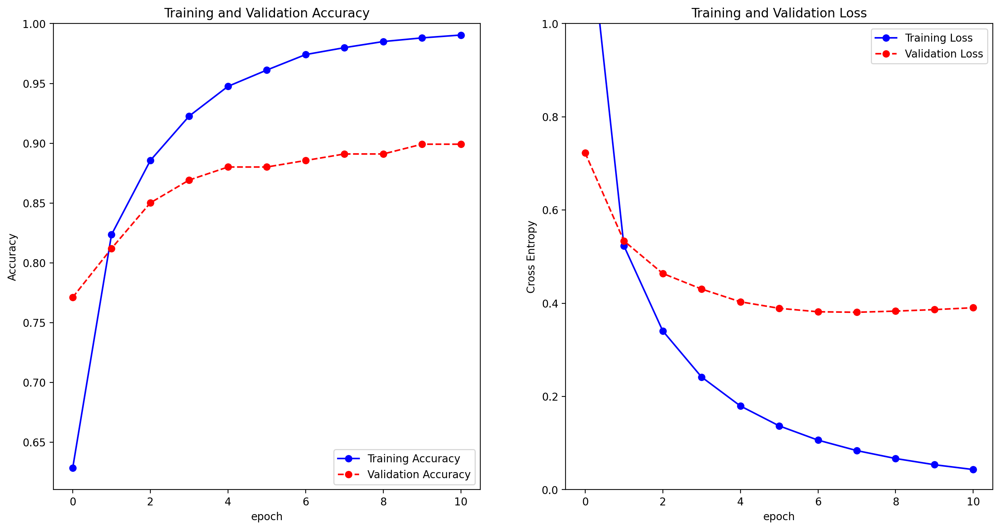

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[1.25055649e-07 3.96580481e-06 9.46187496e-01 2.47749244e-06
  5.38058914e-02]
 [1.00000000e+00 1.92692945e-11 3.99858549e-11 1.19885506e-13
  3.97766153e-10]
 [9.43911552e-01 7.98455076e-05 3.07199568e-03 5.29171377e-02
  1.94548193e-05]
 [7.55583369e-06 3.94542003e-05 2.36663714e-01 9.54811730e-06
  7.63279676e-01]
 [9.99116600e-01 4.45962825e-04 9.18419028e-06 2.73361744e-04
  1.54942143e-04]
 [9.99892354e-01 1.03651968e-04 3.64741140e-06 2.77012845e-07
  5.13492573e-08]
 [1.67125184e-02 2.80931732e-03 9.74973917e-01 4.73360997e-03
  7.70580024e-04]
 [1.27989473e-03 9.95328724e-01 3.09098164e-06 3.37518938e-03
  1.30247181e-05]
 [4.63937158e-06 7.29703320e-09 1.15440810e-06 9.99994159e-01
  1.07341147e-09]
 [1.00000000e+00 1.09485936e-11 4.12512445e-13 4.40475521e-12
  1.67428588e-11]
 [9.99947309e-01 5.05581056e-06 2.04582338e-05 1.55593971e-05
  1.15958683e-05]
 [9.94383454e-01 4.97013703e-03 5.36960084e-04 1.06846092e-04
  2.60112688e-06]
 [1.263983

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.84375
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 146ms/step - accuracy: 0.8497 - loss: 0.4030
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.864


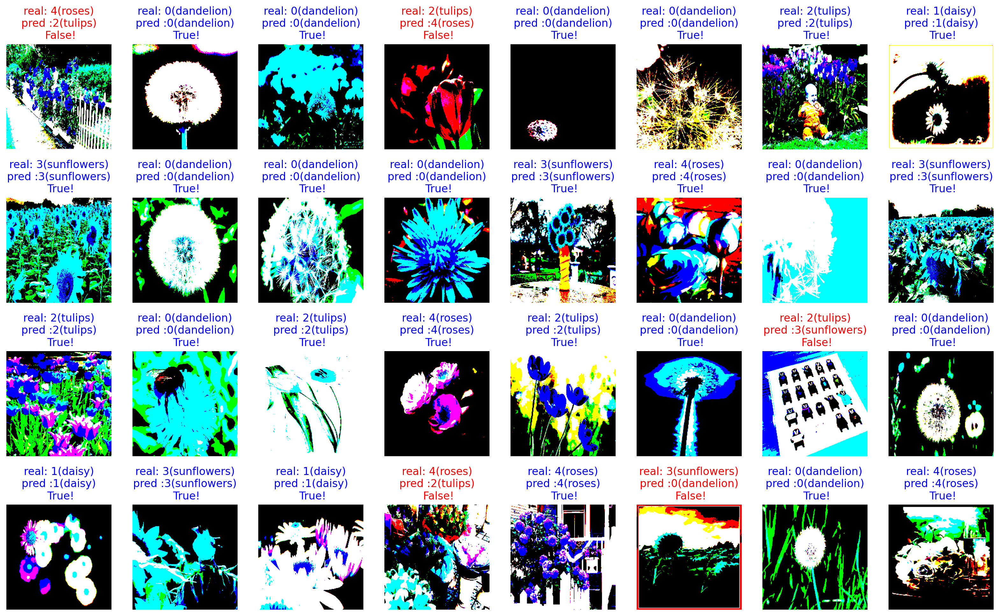

In [12]:
# VGG16 모델 훈련 및 평가 실시
full_train_and_evaluate(model_name='vgg16', img_size=224, num_classes=5, learning_rate=0.0001)

In [17]:
# 모델 정의, 컴파일, 훈련, 평가를 위한 공통 함수(재사용을 위해 정의)
# [수정] 데이터 증식 사용하고, 드롭아웃 추가한 버전
def full_train_and_evaluate_augmented(model_name='', img_size=224, num_classes=5, learning_rate=0.0001):
    IMG_SIZE = img_size    # 각 모델별로 요구하는 이미지 크기
    IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
    NUM_CLASSES = num_classes   # 분류해야 할 클래스 갯수
    LEARNING_RATE = learning_rate   # 학습률

    if model_name == 'vgg16':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                                 include_top=False,   # 상단의 classifier 블록 미포함
                                                 weights='imagenet')
    elif model_name == 'mobilenet':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNet(input_shape=IMG_SHAPE,
                                                     include_top=False,   # 상단의 classifier 블록 미포함
                                                     # dropout=0.001,   # 드롭아웃 비율(기본값: 0.001)
                                                     weights='imagenet')
    elif model_name == 'mobilenet_v2':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                                       include_top=False,   # 상단의 classifier 블록 미포함
                                                       weights='imagenet')
    elif model_name == 'mobilenet_v3_large':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Large(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'mobilenet_v3_small':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Small(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'efficientnet_v2_l':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2L(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    elif model_name == 'efficientnet_v2_s':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2S(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    else:
        raise Exception("모르는 사전 학습 모델명입니다!")

    # 베이스 모델 구조 확인하기
    print("베이스 모델 구조 확인: ")
    base_model.summary()

    # 베이스 모델 구조를 그래프 형식으로 저장
    # model_grapth_full_path = './model_graph/' + model_name + '_base_model_plot.png'
    model_grapth_full_path = '/content/drive/MyDrive/AIFFEL/model_graph/' + model_name + '_augmented_base_model_plot.png'
    plot_model(base_model, to_file=model_grapth_full_path, show_shapes=True, show_layer_names=True)

    # 베이스 모델 블럭은 동결시키기. classifier 블럭만 학습 진행.
    base_model.trainable = False

    # 데이터 증식 추가
    data_augmentation = tf.keras.Sequential(
        [
          tf.keras.layers.RandomFlip('horizontal'),
          tf.keras.layers.RandomRotation(0.1),
          tf.keras.layers.RandomZoom(0.2),
        ]
    )

    # 함수형 API 방식으로 classifier 포함한 최종 모델 구성
    # 모델의 입력 정의
    inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    # inputs = tf.keras.Input(shape=IMG_SHAPE)
    x = data_augmentation(inputs)   # 데이터 증식 레이어 추가
    # [중요] training=False: base_model이 훈련 모드가 아닌 평가 모드로 동작하도록 설정!
    # (evaluate 실행 시 해당 모델에 있는 배치 정규화, 드롭아웃 등이 적용되지 않도록 보장함!!)
    x = base_model(x, training=False)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    # GlobalAveragePooling2D 레이어 통과 후의 텐서(일반적으로 (batches, channels) 형태)에서 두 번째 차원인 channels 값 추출
    # 이 값이 다음 Dense 레이어의 유닛 개수가 됨!
    channels = x.shape[1]
    x = tf.keras.layers.Dense(channels, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    outputs = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

    # 함수형 API로 모델 정의
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # 전체 모델 구조 확인하기
    print("전체 모델 구조 확인: ")
    model.summary()

    model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=LEARNING_RATE),
                  loss=tf.keras.losses.sparse_categorical_crossentropy,
                  metrics=['accuracy'])

    # 훈련 시작 전 완전 초기 상태에서 20 스텝만 평가해 보기
    # 검증용 배치 총 갯수가 여기에서 지정한 숫자보다 적은 경우, UserWarning: Your input ran out of data; interrupting training. 경고 발생함.
    # 따라서, 다음과 같이 미리 배치 수를 확인해서 스텝 수를 지정하는 것이 필요함.
    # 검증용 데이터셋 배치 수 확인
    num_batches = len(validation_batches)
    # validation_steps = 20
    validation_steps = min(20, num_batches)  # 데이터셋의 배치 수를 초과하지 않도록 조정
    loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 손실값: {:.2f}".format(loss0))
    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 정확도: {:.2f}".format(accuracy0))

    # 콜백 정의
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True)

    # 모델 체크포인트 저장할 파일 이름
    # checkpoint_filepath = './best_model/' + model_name + '_best_model.keras'
    checkpoint_filepath = '/content/drive/MyDrive/AIFFEL/best_model/' + model_name + '_augmented_best_model.keras'
    model_checkpoint = ModelCheckpoint(
        filepath=checkpoint_filepath,
        monitor='val_loss',
        save_best_only=True)

    # 훈련 실시
    print("훈련 시작...")
    EPOCHS = 20
    history = model.fit(train_batches,
                        epochs=EPOCHS,
                        validation_data=validation_batches,
                        callbacks=[early_stopping, model_checkpoint])
    print("훈련 종료!!")

    # 훈련 곡선, 검증 곡선 표시
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # epochs_range = range(len(acc))

    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.plot(acc, 'bo-', label='Training Accuracy')     # 대시선
    plt.plot(val_acc, 'ro--', label='Validation Accuracy')
    # plt.plot(epochs_range, acc, 'bo-', label='Training Accuracy')     # 대시선
    # plt.plot(epochs_range, val_acc, 'ro--', label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.ylabel('Accuracy')
    plt.ylim([min(plt.ylim()),1])
    plt.title('Training and Validation Accuracy')
    plt.xlabel('epoch')

    plt.subplot(1, 2, 2)
    plt.plot(loss, 'bo-', label='Training Loss')
    plt.plot(val_loss, 'ro--', label='Validation Loss')
    # plt.plot(epochs_range, loss, 'bo-', label='Training Loss')
    # plt.plot(epochs_range, val_loss, 'ro--', label='Validation Loss')
    # plt.plot(val_loss, 'ro:', label='Validation Loss')    # 점선
    plt.legend(loc='upper right')
    plt.ylabel('Cross Entropy')
    plt.ylim([0,1.0])
    plt.title('Training and Validation Loss')
    plt.xlabel('epoch')
    plt.show()

    # 테스트 배치 하나(batch_size=32인 경우, 32개의 샘플 이미지)만 가져와서 예측해 보기
    # softmax 함수를 통과해서 0~1 사이의 확률값으로 출력됨.
    for image_batch, label_batch in test_batches.take(1):
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)

    print(f"테스트 배치 #1에 대해 실시한 예측 확률값 리스트: {predictions}")

    predictions = np.argmax(predictions, axis=1)    # 2D 배열의 각 행에 대해 가장 큰 값의 인덱스를 반환
    print(f"테스트 배치 #1에 대해서만 실시한 예측 레이블 리스트: {predictions}")

    # 테스트 배치 #1에 대한 예측 결과를 이미지와 함께 표시
    # [참고] 이미지의 각 픽셀값은 타입 캐스팅, 스케일링, 정규화, 채널 순서 변경 등이 이루어져 있는 상태라 일반적인 이미지처럼 표시되지는 않음.
    # 그냥 전체 32개 샘플 중 몇 개를 틀렸는지만 확인해 보는 용도로 사용하기
    plt.figure(figsize=(20, 12))

    get_label_name = metadata.features['label'].int2str   # int2str: 정수형 레이블을 문자열 레이블로 변환

    for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
        plt.subplot(4, 8, idx+1)
        # image = (image + 1) / 2   # -1부터 1까지의 값을 --> 0~1 사이의 값으로 변환
        plt.imshow(image)
        correct = label == prediction
        title = f'real: {label}({get_label_name(label)})\npred :{prediction}({get_label_name(prediction)})\n {correct}!'
        if not correct:
            plt.title(title, fontdict={'color': 'red'})
        else:
            plt.title(title, fontdict={'color': 'blue'})
        plt.axis('off')

    count = 0
    for image, label, prediction in zip(images, labels, predictions):
        correct = label == prediction
        if correct:
            count = count + 1

    print(f"테스트 배치 #1에 대해서만 실시한 예측 정확도: {count / 32}")

    # 테스트 데이터셋 전체에 대해 최종 평가 진행
    loss, acc = model.evaluate(test_batches)
    print(f"전체 테스트 데이터셋에 대해 평가한 최종 정확도: {acc:.3f}")

베이스 모델 구조 확인: 


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

전체 모델 구조 확인: 


Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential (Sequential)              │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_3           │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,979,909 (57.14 MB)

 Trainable params: 265,221 (1.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 8s 318ms/step - accuracy: 0.1879 - loss: 5.2930
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 5.23
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.20
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 22s 210ms/step - accuracy: 0.3413 - loss: 3.9006 - val_accuracy: 0.7302 - val_loss: 0.8729
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17s 182ms/step - accuracy: 0.6015 - loss: 1.7424 - val_accuracy: 0.8229 - val_loss: 0.6265
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17s 187ms/step - accuracy: 0.7063 - loss: 1.2004 - val_accuracy: 0.8365 - val_loss: 0.5456
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 18s 199ms/step - accuracy: 0.7287 - loss: 0.9545 - val_accuracy: 0.8610 - val_loss: 0.4969
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 190ms/step - accuracy: 0.7629 - loss: 0.8750 - val_accuracy: 0.8583 - val_loss: 0.4628
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 190ms/step - accuracy: 0.7889 - loss: 0.7120 - val_accuracy: 0.8747 - val_loss: 0.4268
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17

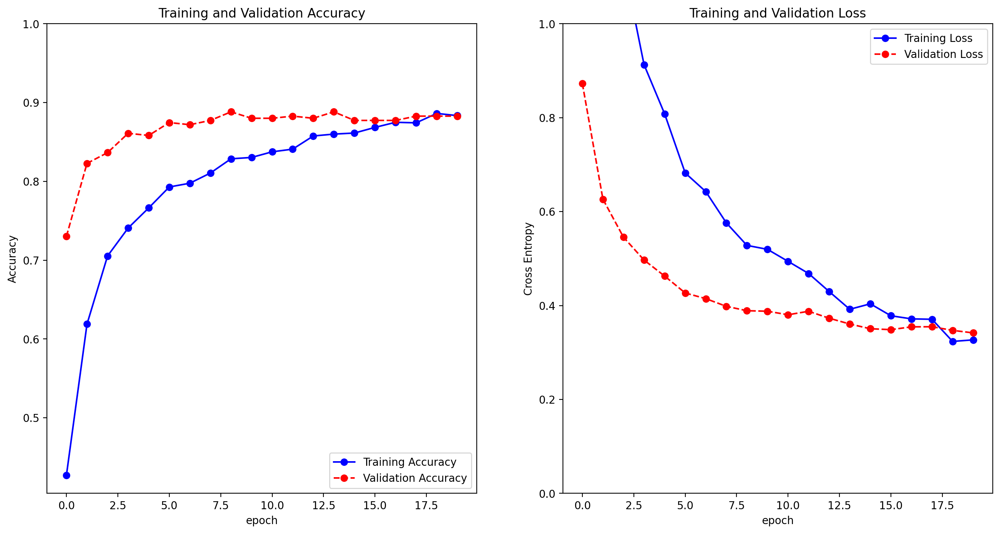

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[6.74052636e-09 3.47996689e-08 9.95638430e-01 3.93996435e-09
  4.36162669e-03]
 [1.00000000e+00 2.00583092e-11 1.49835792e-14 2.46034725e-12
  1.58726097e-14]
 [5.05896509e-01 7.03828046e-05 3.70539888e-03 4.90204155e-01
  1.23548161e-04]
 [5.95828078e-06 6.06779795e-05 5.98585069e-01 1.17835953e-06
  4.01347041e-01]
 [9.98751402e-01 3.68778798e-04 2.01300409e-05 8.53830948e-04
  5.90833497e-06]
 [9.99997020e-01 2.13888165e-06 8.94906815e-09 8.30523675e-07
  3.87718607e-10]
 [6.06336491e-03 2.19046157e-02 9.44956422e-01 2.54266779e-03
  2.45328937e-02]
 [3.64915989e-02 9.10195649e-01 1.18076656e-04 5.30291758e-02
  1.65567049e-04]
 [2.20072950e-04 7.46115880e-09 2.46344880e-05 9.99755204e-01
  1.18586696e-08]
 [1.00000000e+00 9.70178451e-12 1.52249143e-17 6.46738725e-14
  9.54792413e-17]
 [9.99993324e-01 2.21557093e-06 3.67640018e-06 4.02309297e-07
  3.74104076e-07]
 [9.19306755e-01 6.72897995e-02 6.86907966e-04 1.27076041e-02
  8.92527441e-06]
 [1.302349

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.90625
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 149ms/step - accuracy: 0.8881 - loss: 0.3504
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.894


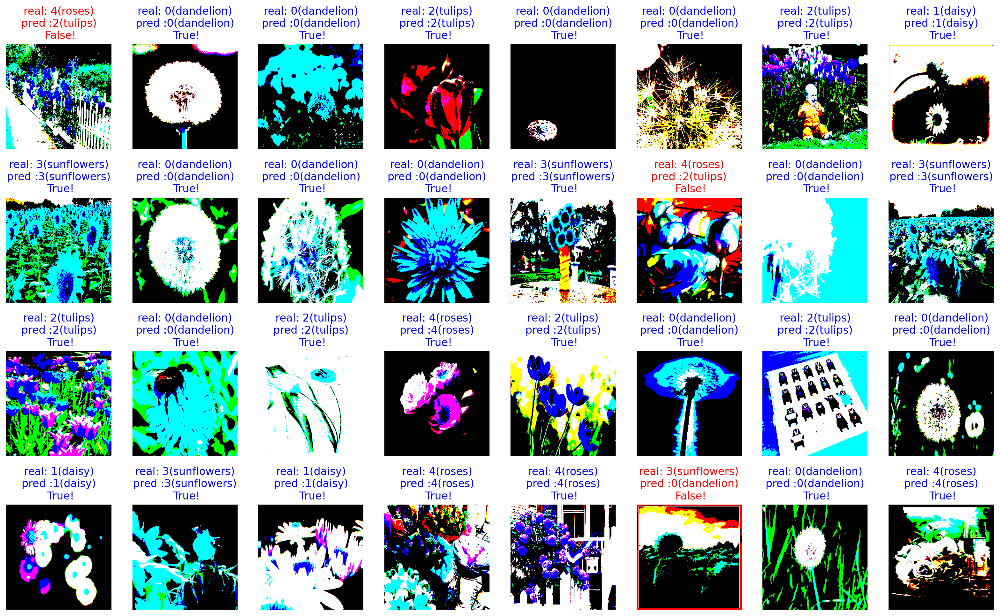

In [18]:
# VGG16 모델 훈련 및 평가 실시: 데이터 증식 사용하고, 드롭아웃 추가한 버전
full_train_and_evaluate_augmented(model_name='vgg16', img_size=224, num_classes=5, learning_rate=0.0001)

In [15]:
# 모델 정의, 컴파일, 훈련, 평가를 위한 공통 함수(재사용을 위해 정의)
# [수정] 베이스 모델의 마지막 4개층을 동결 해제하고, 드롭아웃 레이어 추가한 버전
def full_train_and_evaluate_finetuned_last4(model_name='', img_size=224, num_classes=5, learning_rate=0.0001):
    IMG_SIZE = img_size    # 각 모델별로 요구하는 이미지 크기
    IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
    NUM_CLASSES = num_classes   # 분류해야 할 클래스 갯수
    LEARNING_RATE = learning_rate   # 학습률

    if model_name == 'vgg16':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                                 include_top=False,   # 상단의 classifier 블록 미포함
                                                 weights='imagenet')
    elif model_name == 'mobilenet':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNet(input_shape=IMG_SHAPE,
                                                     include_top=False,   # 상단의 classifier 블록 미포함
                                                     # dropout=0.001,   # 드롭아웃 비율(기본값: 0.001)
                                                     weights='imagenet')
    elif model_name == 'mobilenet_v2':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                                       include_top=False,   # 상단의 classifier 블록 미포함
                                                       weights='imagenet')
    elif model_name == 'mobilenet_v3_large':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Large(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'mobilenet_v3_small':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Small(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'efficientnet_v2_l':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2L(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    elif model_name == 'efficientnet_v2_s':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2S(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    else:
        raise Exception("모르는 사전 학습 모델명입니다!")

    # 베이스 모델 구조 확인하기
    print("베이스 모델 구조 확인: ")
    base_model.summary()

    # 베이스 모델 구조를 그래프 형식으로 저장
    # model_grapth_full_path = './model_graph/' + model_name + '_base_model_plot.png'
    model_grapth_full_path = '/content/drive/MyDrive/AIFFEL/model_graph/' + model_name + '_finetuned_last4_base_model_plot.png'
    plot_model(base_model, to_file=model_grapth_full_path, show_shapes=True, show_layer_names=True)

    # # 베이스 모델 블럭은 동결시키기. classifier 블럭만 학습 진행.
    # base_model.trainable = False
    # 베이스 모델 블럭 중 마지막 4개 층(블럭 5에 해당하는 층) 제외하고 모두 동결
    base_model.trainable = True
    for layer in base_model.layers[:-4]:
        layer.trainable = False

    # 함수형 API 방식으로 classifier 포함한 최종 모델 구성
    # 모델의 입력 정의
    inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    # inputs = tf.keras.Input(shape=IMG_SHAPE)
    # [중요] training=False: base_model이 훈련 모드가 아닌 평가 모드로 동작하도록 설정!
    # (evaluate 실행 시 해당 모델에 있는 배치 정규화, 드롭아웃 등이 적용되지 않도록 보장함!!)
    x = base_model(inputs, training=False)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    # GlobalAveragePooling2D 레이어 통과 후의 텐서(일반적으로 (batches, channels) 형태)에서 두 번째 차원인 channels 값 추출
    # 이 값이 다음 Dense 레이어의 유닛 개수가 됨!
    channels = x.shape[1]
    x = tf.keras.layers.Dense(channels, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.5)(x)   # 드롭아웃 레이어 추가
    outputs = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

    # 함수형 API로 모델 정의
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # 전체 모델 구조 확인하기
    print("전체 모델 구조 확인: ")
    model.summary()

    model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=LEARNING_RATE),
                  loss=tf.keras.losses.sparse_categorical_crossentropy,
                  metrics=['accuracy'])

    # 훈련 시작 전 완전 초기 상태에서 20 스텝만 평가해 보기
    # 검증용 배치 총 갯수가 여기에서 지정한 숫자보다 적은 경우, UserWarning: Your input ran out of data; interrupting training. 경고 발생함.
    # 따라서, 다음과 같이 미리 배치 수를 확인해서 스텝 수를 지정하는 것이 필요함.
    # 검증용 데이터셋 배치 수 확인
    num_batches = len(validation_batches)
    # validation_steps = 20
    validation_steps = min(20, num_batches)  # 데이터셋의 배치 수를 초과하지 않도록 조정
    loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 손실값: {:.2f}".format(loss0))
    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 정확도: {:.2f}".format(accuracy0))

    # 콜백 정의
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True)

    # 모델 체크포인트 저장할 파일 이름
    # checkpoint_filepath = './best_model/' + model_name + '_best_model.keras'
    checkpoint_filepath = '/content/drive/MyDrive/AIFFEL/best_model/' + model_name + '_finetunred_last4_best_model.keras'
    model_checkpoint = ModelCheckpoint(
        filepath=checkpoint_filepath,
        monitor='val_loss',
        save_best_only=True)

    # 훈련 실시
    print("훈련 시작...")
    EPOCHS = 20
    history = model.fit(train_batches,
                        epochs=EPOCHS,
                        validation_data=validation_batches,
                        callbacks=[early_stopping, model_checkpoint])
    print("훈련 종료!!")

    # 훈련 곡선, 검증 곡선 표시
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # epochs_range = range(len(acc))

    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.plot(acc, 'bo-', label='Training Accuracy')     # 대시선
    plt.plot(val_acc, 'ro--', label='Validation Accuracy')
    # plt.plot(epochs_range, acc, 'bo-', label='Training Accuracy')     # 대시선
    # plt.plot(epochs_range, val_acc, 'ro--', label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.ylabel('Accuracy')
    plt.ylim([min(plt.ylim()),1])
    plt.title('Training and Validation Accuracy')
    plt.xlabel('epoch')

    plt.subplot(1, 2, 2)
    plt.plot(loss, 'bo-', label='Training Loss')
    plt.plot(val_loss, 'ro--', label='Validation Loss')
    # plt.plot(epochs_range, loss, 'bo-', label='Training Loss')
    # plt.plot(epochs_range, val_loss, 'ro--', label='Validation Loss')
    # plt.plot(val_loss, 'ro:', label='Validation Loss')    # 점선
    plt.legend(loc='upper right')
    plt.ylabel('Cross Entropy')
    plt.ylim([0,1.0])
    plt.title('Training and Validation Loss')
    plt.xlabel('epoch')
    plt.show()

    # 테스트 배치 하나(batch_size=32인 경우, 32개의 샘플 이미지)만 가져와서 예측해 보기
    # softmax 함수를 통과해서 0~1 사이의 확률값으로 출력됨.
    for image_batch, label_batch in test_batches.take(1):
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)

    print(f"테스트 배치 #1에 대해 실시한 예측 확률값 리스트: {predictions}")

    predictions = np.argmax(predictions, axis=1)    # 2D 배열의 각 행에 대해 가장 큰 값의 인덱스를 반환
    print(f"테스트 배치 #1에 대해서만 실시한 예측 레이블 리스트: {predictions}")

    # 테스트 배치 #1에 대한 예측 결과를 이미지와 함께 표시
    # [참고] 이미지의 각 픽셀값은 타입 캐스팅, 스케일링, 정규화, 채널 순서 변경 등이 이루어져 있는 상태라 일반적인 이미지처럼 표시되지는 않음.
    # 그냥 전체 32개 샘플 중 몇 개를 틀렸는지만 확인해 보는 용도로 사용하기
    plt.figure(figsize=(20, 12))

    get_label_name = metadata.features['label'].int2str   # int2str: 정수형 레이블을 문자열 레이블로 변환

    for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
        plt.subplot(4, 8, idx+1)
        # image = (image + 1) / 2   # -1부터 1까지의 값을 --> 0~1 사이의 값으로 변환
        plt.imshow(image)
        correct = label == prediction
        title = f'real: {label}({get_label_name(label)})\npred :{prediction}({get_label_name(prediction)})\n {correct}!'
        if not correct:
            plt.title(title, fontdict={'color': 'red'})
        else:
            plt.title(title, fontdict={'color': 'blue'})
        plt.axis('off')

    count = 0
    for image, label, prediction in zip(images, labels, predictions):
        correct = label == prediction
        if correct:
            count = count + 1

    print(f"테스트 배치 #1에 대해서만 실시한 예측 정확도: {count / 32}")

    # 테스트 데이터셋 전체에 대해 최종 평가 진행
    loss, acc = model.evaluate(test_batches)
    print(f"전체 테스트 데이터셋에 대해 평가한 최종 정확도: {acc:.3f}")

베이스 모델 구조 확인: 


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

전체 모델 구조 확인: 


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_2           │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,979,909 (57.14 MB)

 Trainable params: 7,344,645 (28.02 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 142ms/step - accuracy: 0.1989 - loss: 6.7233
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 6.48
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.20
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 21s 195ms/step - accuracy: 0.5058 - loss: 1.6702 - val_accuracy: 0.8283 - val_loss: 0.6511
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 18s 185ms/step - accuracy: 0.8278 - loss: 0.4984 - val_accuracy: 0.8992 - val_loss: 0.3344
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 184ms/step - accuracy: 0.8950 - loss: 0.3411 - val_accuracy: 0.9210 - val_loss: 0.2567
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 175ms/step - accuracy: 0.9260 - loss: 0.2402 - val_accuracy: 0.9101 - val_loss: 0.2822
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 21s 176ms/step - accuracy: 0.9487 - loss: 0.1628 - val_accuracy: 0.9128 - val_loss: 0.3386
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 16s 177ms/step - accuracy: 0.9610 - loss: 0.1693 - val_accuracy: 0.9210 - val_loss: 0.3298
훈련 종료!!


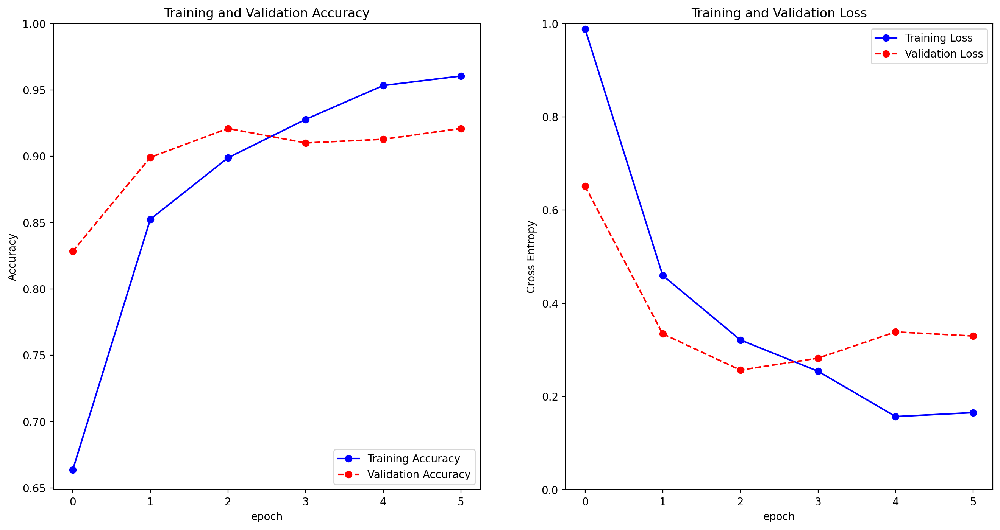

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[9.74825304e-03 4.37304424e-03 6.63335860e-01 6.82128314e-03
  3.15721571e-01]
 [1.00000000e+00 6.45544571e-40 8.40779079e-45 3.40515527e-43
  3.22478714e-39]
 [9.86971200e-01 1.96293858e-03 1.30573369e-03 8.73755664e-03
  1.02245761e-03]
 [6.32054405e-04 7.41813972e-04 9.92146194e-01 1.41421077e-03
  5.06576570e-03]
 [1.00000000e+00 2.15288985e-12 2.27405426e-14 9.73666338e-14
  9.86271103e-15]
 [1.00000000e+00 1.24352171e-18 3.71185546e-21 6.63250091e-17
  9.29190428e-18]
 [2.98824252e-05 9.87803578e-05 9.98303413e-01 7.63905933e-04
  8.03964736e-04]
 [6.34311377e-08 9.99999762e-01 1.91896099e-09 8.58075850e-08
  6.51653620e-09]
 [5.16992005e-10 1.40493728e-11 5.97241562e-11 1.00000000e+00
  4.92472729e-11]
 [1.00000000e+00 2.84238612e-29 2.96146378e-34 3.95711224e-31
  3.00575643e-29]
 [1.00000000e+00 7.40083417e-26 1.44274518e-28 1.13221545e-22
  6.78341966e-24]
 [9.38267112e-01 1.70425288e-02 1.17803467e-02 1.60330851e-02
  1.68769322e-02]
 [3.249307

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.90625
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 118ms/step - accuracy: 0.9312 - loss: 0.2307
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.937


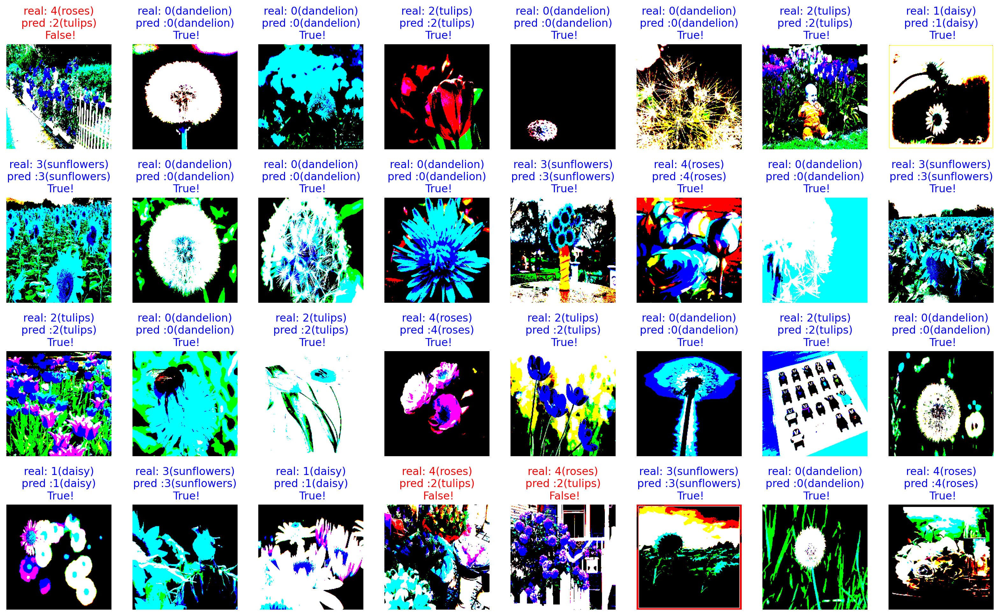

In [16]:
# VGG16 모델 훈련 및 평가 실시: 마지막 4개 층 동결 해제하고, 드롭아웃 레이어 추가한 버전
full_train_and_evaluate_finetuned_last4(model_name='vgg16', img_size=224, num_classes=5, learning_rate=0.0001)

In [19]:
# 모델 정의, 컴파일, 훈련, 평가를 위한 공통 함수(재사용을 위해 정의)
# [수정] 베이스 모델 마지막 4개층 동결 해제하고, 데이터 증식 사용하고, 드롭아웃 추가한 버전
def full_train_and_evaluate_finetuned_augmented(model_name='', img_size=224, num_classes=5, learning_rate=0.0001):
    IMG_SIZE = img_size    # 각 모델별로 요구하는 이미지 크기
    IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
    NUM_CLASSES = num_classes   # 분류해야 할 클래스 갯수
    LEARNING_RATE = learning_rate   # 학습률

    if model_name == 'vgg16':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                                 include_top=False,   # 상단의 classifier 블록 미포함
                                                 weights='imagenet')
    elif model_name == 'mobilenet':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNet(input_shape=IMG_SHAPE,
                                                     include_top=False,   # 상단의 classifier 블록 미포함
                                                     # dropout=0.001,   # 드롭아웃 비율(기본값: 0.001)
                                                     weights='imagenet')
    elif model_name == 'mobilenet_v2':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                                       include_top=False,   # 상단의 classifier 블록 미포함
                                                       weights='imagenet')
    elif model_name == 'mobilenet_v3_large':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Large(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'mobilenet_v3_small':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.MobileNetV3Small(input_shape=IMG_SHAPE,
                                                            include_top=False,   # 상단의 classifier 블록 미포함
                                                            # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                            weights='imagenet')
    elif model_name == 'efficientnet_v2_l':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2L(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    elif model_name == 'efficientnet_v2_s':
        # Create the base model from the pre-trained model
        base_model = tf.keras.applications.EfficientNetV2S(input_shape=IMG_SHAPE,
                                                           include_top=False,   # 상단의 classifier 블록 미포함
                                                           # dropout_rate=0.2,   # 마지막 레이어의 드롭아웃 비율(기본값: 0.2)
                                                           weights='imagenet',
                                                           # 기본적으로 입력 전처리가 모델의 일부로 포함됨. (EfficientNetV2 모델의 특징)
                                                           # 사실 EfficientNetV2 모델의 preprocess_input 함수는 실제로 처리하는 것은 없음.(바이패스)
                                                           # 그리고, 이 모델은 입력 텐서가 0~255의 값을 부동소수점 형식으로 가지는 텐서를 기대함.
                                                           # 만약, include_preprocessing=False로 지정하는 경우에는, 모델에서 -1 부터 1까지의 부동소수점 형식의 입력 텐서를 기대하므로, 수작업으로 직접 전처리해주어야 함!
                                                           include_preprocessing=True)
    else:
        raise Exception("모르는 사전 학습 모델명입니다!")

    # 베이스 모델 구조 확인하기
    print("베이스 모델 구조 확인: ")
    base_model.summary()

    # 베이스 모델 구조를 그래프 형식으로 저장
    # model_grapth_full_path = './model_graph/' + model_name + '_base_model_plot.png'
    model_grapth_full_path = '/content/drive/MyDrive/AIFFEL/model_graph/' + model_name + '_augmented_base_model_plot.png'
    plot_model(base_model, to_file=model_grapth_full_path, show_shapes=True, show_layer_names=True)

    # # 베이스 모델 블럭은 동결시키기. classifier 블럭만 학습 진행.
    # base_model.trainable = False
    # 베이스 모델 블럭 중 마지막 4개 층(블럭 5에 해당하는 층) 제외하고 모두 동결
    base_model.trainable = True
    for layer in base_model.layers[:-4]:
        layer.trainable = False

    # 데이터 증식 추가
    data_augmentation = tf.keras.Sequential(
        [
          tf.keras.layers.RandomFlip('horizontal'),
          tf.keras.layers.RandomRotation(0.1),
          tf.keras.layers.RandomZoom(0.2),
        ]
    )

    # 함수형 API 방식으로 classifier 포함한 최종 모델 구성
    # 모델의 입력 정의
    inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    # inputs = tf.keras.Input(shape=IMG_SHAPE)
    x = data_augmentation(inputs)   # 데이터 증식 레이어 추가
    # [중요] training=False: base_model이 훈련 모드가 아닌 평가 모드로 동작하도록 설정!
    # (evaluate 실행 시 해당 모델에 있는 배치 정규화, 드롭아웃 등이 적용되지 않도록 보장함!!)
    x = base_model(x, training=False)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    # GlobalAveragePooling2D 레이어 통과 후의 텐서(일반적으로 (batches, channels) 형태)에서 두 번째 차원인 channels 값 추출
    # 이 값이 다음 Dense 레이어의 유닛 개수가 됨!
    channels = x.shape[1]
    x = tf.keras.layers.Dense(channels, activation='relu')(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    outputs = tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')(x)

    # 함수형 API로 모델 정의
    model = tf.keras.Model(inputs=inputs, outputs=outputs)

    # 전체 모델 구조 확인하기
    print("전체 모델 구조 확인: ")
    model.summary()

    model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=LEARNING_RATE),
                  loss=tf.keras.losses.sparse_categorical_crossentropy,
                  metrics=['accuracy'])

    # 훈련 시작 전 완전 초기 상태에서 20 스텝만 평가해 보기
    # 검증용 배치 총 갯수가 여기에서 지정한 숫자보다 적은 경우, UserWarning: Your input ran out of data; interrupting training. 경고 발생함.
    # 따라서, 다음과 같이 미리 배치 수를 확인해서 스텝 수를 지정하는 것이 필요함.
    # 검증용 데이터셋 배치 수 확인
    num_batches = len(validation_batches)
    # validation_steps = 20
    validation_steps = min(20, num_batches)  # 데이터셋의 배치 수를 초과하지 않도록 조정
    loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 손실값: {:.2f}".format(loss0))
    print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 정확도: {:.2f}".format(accuracy0))

    # 콜백 정의
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True)

    # 모델 체크포인트 저장할 파일 이름
    # checkpoint_filepath = './best_model/' + model_name + '_best_model.keras'
    checkpoint_filepath = '/content/drive/MyDrive/AIFFEL/best_model/' + model_name + '_augmented_best_model.keras'
    model_checkpoint = ModelCheckpoint(
        filepath=checkpoint_filepath,
        monitor='val_loss',
        save_best_only=True)

    # 훈련 실시
    print("훈련 시작...")
    EPOCHS = 20
    history = model.fit(train_batches,
                        epochs=EPOCHS,
                        validation_data=validation_batches,
                        callbacks=[early_stopping, model_checkpoint])
    print("훈련 종료!!")

    # 훈련 곡선, 검증 곡선 표시
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']

    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # epochs_range = range(len(acc))

    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.plot(acc, 'bo-', label='Training Accuracy')     # 대시선
    plt.plot(val_acc, 'ro--', label='Validation Accuracy')
    # plt.plot(epochs_range, acc, 'bo-', label='Training Accuracy')     # 대시선
    # plt.plot(epochs_range, val_acc, 'ro--', label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.ylabel('Accuracy')
    plt.ylim([min(plt.ylim()),1])
    plt.title('Training and Validation Accuracy')
    plt.xlabel('epoch')

    plt.subplot(1, 2, 2)
    plt.plot(loss, 'bo-', label='Training Loss')
    plt.plot(val_loss, 'ro--', label='Validation Loss')
    # plt.plot(epochs_range, loss, 'bo-', label='Training Loss')
    # plt.plot(epochs_range, val_loss, 'ro--', label='Validation Loss')
    # plt.plot(val_loss, 'ro:', label='Validation Loss')    # 점선
    plt.legend(loc='upper right')
    plt.ylabel('Cross Entropy')
    plt.ylim([0,1.0])
    plt.title('Training and Validation Loss')
    plt.xlabel('epoch')
    plt.show()

    # 테스트 배치 하나(batch_size=32인 경우, 32개의 샘플 이미지)만 가져와서 예측해 보기
    # softmax 함수를 통과해서 0~1 사이의 확률값으로 출력됨.
    for image_batch, label_batch in test_batches.take(1):
        images = image_batch
        labels = label_batch
        predictions = model.predict(image_batch)

    print(f"테스트 배치 #1에 대해 실시한 예측 확률값 리스트: {predictions}")

    predictions = np.argmax(predictions, axis=1)    # 2D 배열의 각 행에 대해 가장 큰 값의 인덱스를 반환
    print(f"테스트 배치 #1에 대해서만 실시한 예측 레이블 리스트: {predictions}")

    # 테스트 배치 #1에 대한 예측 결과를 이미지와 함께 표시
    # [참고] 이미지의 각 픽셀값은 타입 캐스팅, 스케일링, 정규화, 채널 순서 변경 등이 이루어져 있는 상태라 일반적인 이미지처럼 표시되지는 않음.
    # 그냥 전체 32개 샘플 중 몇 개를 틀렸는지만 확인해 보는 용도로 사용하기
    plt.figure(figsize=(20, 12))

    get_label_name = metadata.features['label'].int2str   # int2str: 정수형 레이블을 문자열 레이블로 변환

    for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
        plt.subplot(4, 8, idx+1)
        # image = (image + 1) / 2   # -1부터 1까지의 값을 --> 0~1 사이의 값으로 변환
        plt.imshow(image)
        correct = label == prediction
        title = f'real: {label}({get_label_name(label)})\npred :{prediction}({get_label_name(prediction)})\n {correct}!'
        if not correct:
            plt.title(title, fontdict={'color': 'red'})
        else:
            plt.title(title, fontdict={'color': 'blue'})
        plt.axis('off')

    count = 0
    for image, label, prediction in zip(images, labels, predictions):
        correct = label == prediction
        if correct:
            count = count + 1

    print(f"테스트 배치 #1에 대해서만 실시한 예측 정확도: {count / 32}")

    # 테스트 데이터셋 전체에 대해 최종 평가 진행
    loss, acc = model.evaluate(test_batches)
    print(f"전체 테스트 데이터셋에 대해 평가한 최종 정확도: {acc:.3f}")

베이스 모델 구조 확인: 


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

전체 모델 구조 확인: 


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_10 (InputLayer)          │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential_1 (Sequential)            │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_4           │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,979,909 (57.14 MB)

 Trainable params: 7,344,645 (28.02 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 149ms/step - accuracy: 0.1848 - loss: 6.8760
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 6.92
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.15
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 23s 220ms/step - accuracy: 0.4878 - loss: 1.6577 - val_accuracy: 0.8692 - val_loss: 0.4068
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 21s 226ms/step - accuracy: 0.7984 - loss: 0.5436 - val_accuracy: 0.9019 - val_loss: 0.3551
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 39s 208ms/step - accuracy: 0.8659 - loss: 0.4057 - val_accuracy: 0.8610 - val_loss: 0.3795
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 21s 216ms/step - accuracy: 0.8797 - loss: 0.3657 - val_accuracy: 0.8992 - val_loss: 0.2938
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 19s 204ms/step - accuracy: 0.9026 - loss: 0.3196 - val_accuracy: 0.9210 - val_loss: 0.2990
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 213ms/step - accuracy: 0.9095 - loss: 0.2812 - val_accuracy: 0.9101 - val_loss: 0.2928
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20

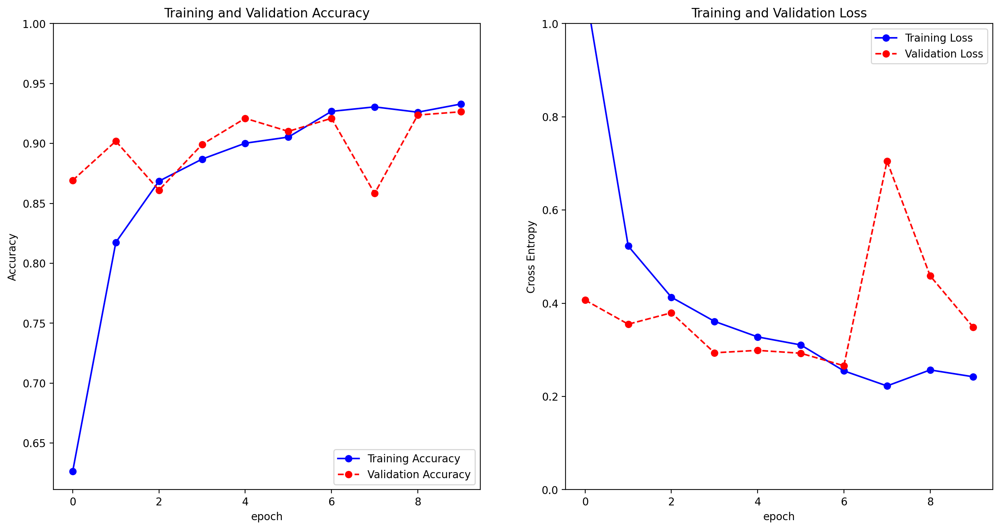

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[7.46506260e-11 5.69984650e-11 7.54975498e-01 1.05788178e-09
  2.45024487e-01]
 [1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00]
 [9.50121582e-01 1.38591286e-02 1.28759779e-02 1.37756495e-02
  9.36762523e-03]
 [9.13974052e-09 1.03901264e-07 9.95586276e-01 1.08834382e-08
  4.41364385e-03]
 [1.00000000e+00 1.19796751e-14 6.30790399e-17 2.92877424e-17
  7.53546752e-19]
 [9.99991417e-01 6.37844096e-07 6.78694050e-07 5.57831709e-06
  1.78581308e-06]
 [8.49580619e-14 3.86495035e-13 1.00000000e+00 3.04010994e-13
  2.78052936e-09]
 [2.02384509e-09 1.00000000e+00 5.09451509e-11 1.20838816e-11
  3.22294105e-14]
 [1.82408793e-11 4.90451643e-15 4.82743457e-13 1.00000000e+00
  6.86721255e-14]
 [1.00000000e+00 8.91503857e-24 1.21716036e-25 2.00864767e-27
  1.98693462e-28]
 [1.00000000e+00 1.44886501e-12 2.54548092e-13 1.28882351e-13
  3.90518509e-14]
 [8.79200161e-01 1.24452179e-02 3.57531160e-02 3.41150723e-02
  3.84864733e-02]
 [3.915092

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.875
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 148ms/step - accuracy: 0.9346 - loss: 0.2038
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.937


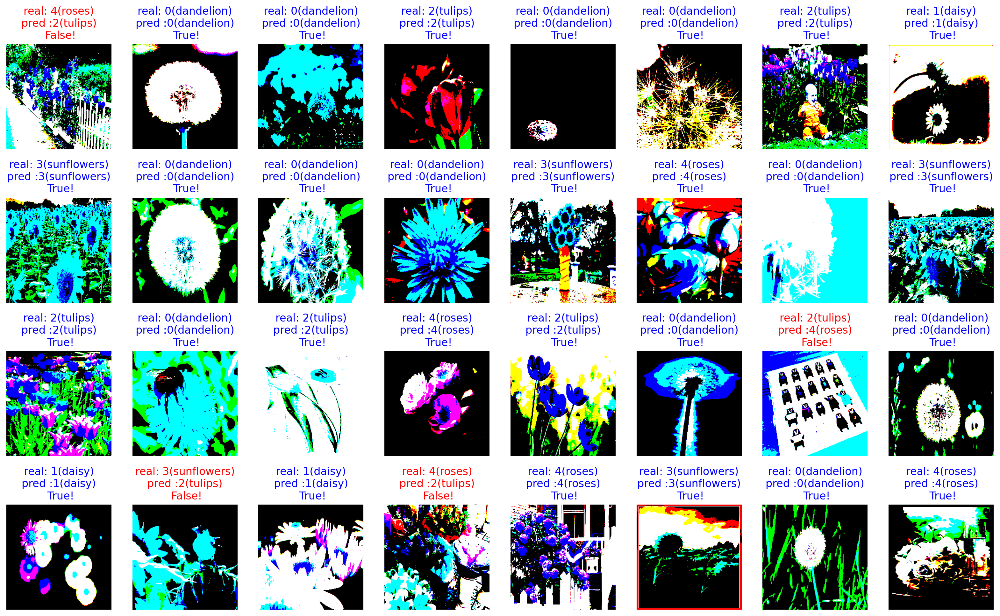

In [20]:
# VGG16 모델 훈련 및 평가 실시: 데이터 증식 사용하고, 드롭아웃 추가한 버전
full_train_and_evaluate_finetuned_augmented(model_name='vgg16', img_size=224, num_classes=5, learning_rate=0.0001)

In [ ]:
# 저장된 최적 모델 로드해 평가
# 앞의 결과와 동일함을 알 수 있음!
saved_model_filepath = './best_model/vgg16_best_model.keras'
saved_model = tf.keras.models.load_model(saved_model_filepath)

# 테스트 데이터셋 전체에 대해 최종 평가 진행
loss, acc = saved_model.evaluate(test_batches)
print(f"저장된 최적 모델로 전체 테스트 데이터셋에 대해 평가한 최종 정확도: {acc:.3f}")

12/12 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.8867 - loss: 0.3488
저장된 최적 모델로 전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.891


In [ ]:
IMG_SIZE = 224    # VGG16 모델에서 요구하는 이미지 크기

IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

# Create the base model from the pre-trained model VGG16
base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                         include_top=False,   # 상단의 classifier 블록 미포함
                                         weights='imagenet')

In [ ]:
# 베이스 모델 구조 확인하기
base_model.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_10 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# 베이스 모델 구조를 그래프로 표시하기
from tensorflow.keras.utils import plot_model

# 모델 구조를 그래프 형식으로 저장
plot_model(base_model, to_file='./model_graph/vgg16_base_model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# 첫번재 배치인 image_batch 데이터를 모델에 통과시켰을 때 최종 결과 배치의 차원 확인하기
# 여기에서 image_batch 객체는 take(1)으로 로드한 첫번째 배치 데이터임. (32개 샘플 이미지 포함)
# CNN 모델인 VGG16 모델을 통과한 후 최종 feature map 사이즈가 (5, 5, 512) 임을 확인할 수 있음!
feature_batch = base_model(image_batch)
feature_batch.shape

TensorShape([32, 7, 7, 512])

In [ ]:
# 베이스 모델 다음에 추가할 GlobalAveragePooling2D 레이어 생성
# [중요] Flatten 레이어 대신 GlobalAveragePooling2D 레이어 사용하는 것임!
# [참고] Flatten 레이어 사용하지 않고 GlobalAveragePooling2D 레이어 사용하는 이유
# 1. 파라미터 수 감소: 그냥 Flatten 레이어 사용하면 파라미터 수가 너무 많아짐.
# 2. 오버피팅 방지: 파라미터 수가 감소 --> 오버피팅 가능성 역시 줄어듬.
# 3. 최종 feature map의 공간적 정보 유지
# 4. 계산 효율성, 모델의 크기 및 학습 속도 개선
# 특히, 대규모 데이터셋과 모델 구조가 복잡한 경우에는 필수적으로 사용해야 함!!
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()

# 베이스 모델 블럭을 통과한 최종 feature_batch를 GlobalAveragePooling2D 레이어에 통과시켰을 때 결과 차원이 어떨지 확인하기
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 512)


In [ ]:
# dense layer에는 unit과 activation 2개의 매개변수만 사용해주세요.
# unit의 값은 위에서 global_average_layer를 통과했을 때의 값을 생각해보세요.
# 활성화 함수는 ReLU를 사용합니다.
dense_layer = tf.keras.layers.Dense(512, activation="relu")
# unit은 우리가 분류하고 싶은 class를 생각해보세요.
# 활성화 함수는 Softmax를 사용합니다.
prediction_layer = tf.keras.layers.Dense(5, activation="softmax")

# feature_batch_averag가 dense_layer를 거치고, 다시 prediction_layer를 거치고 난 결과의 최종 차원 수 확인해 보기
prediction_batch = prediction_layer(dense_layer(feature_batch_average))
print(prediction_batch.shape)

(32, 5)


In [ ]:
# 함수형 API 방식으로 classifier 포함한 최종 모델 구성

# 베이스 모델 블럭은 동결시키기. classifier 블럭만 학습 진행.
base_model.trainable = False

# # classifier 포함한 최종 모델 구성
# model = tf.keras.Sequential([
#   base_model,
#   global_average_layer,
#   dense_layer,
#   prediction_layer
# ])

# 모델의 입력 정의
inputs = tf.keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
# inputs = tf.keras.Input(shape=IMG_SHAPE)
# [중요] training=False: base_model이 훈련 모드가 아닌 평가 모드로 동작하도록 설정!
# (evaluate 실행 시 해당 모델에 있는 배치 정규화, 드롭아웃 등이 적용되지 않도록 보장함!!)
x = base_model(inputs, training=False)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(512, activation='relu')(x)
outputs = tf.keras.layers.Dense(5, activation='softmax')(x)

# 함수형 API로 모델 정의
model = tf.keras.Model(inputs=inputs, outputs=outputs)

# 모델 요약 출력
model.summary()

Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_11 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ vgg16 (Functional)              │ (None, 7, 7, 512)      │    14,714,688 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_11     │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │       262,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 5)              │         2,565 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,979,909 (57.14 MB)

 Trainable params: 265,221 (1.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
learning_rate = 0.0001    # 학습률 지정
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

In [ ]:
# 훈련 시작 전 완전 초기 상태에서 20 스텝만 평가해 보기
# 검증용 배치 총 갯수가 여기에서 지정한 숫자보다 적은 경우, UserWarning: Your input ran out of data; interrupting training. 경고 발생함.
# 따라서, 다음과 같이 미리 배치 수를 확인해서 스텝 수를 지정하는 것이 필요함.
# 검증용 데이터셋 배치 수 확인
num_batches = len(validation_batches)
# validation_steps = 20
validation_steps = min(20, num_batches)  # 데이터셋의 배치 수를 초과하지 않도록 조정
loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 손실값: {:.2f}".format(loss0))
print("훈련 시작 전 초기화 상태에서 검증용 배치 ", validation_steps, "개에 대해 평가한 초기 정확도: {:.2f}".format(accuracy0))

20/20 ━━━━━━━━━━━━━━━━━━━━ 23s 1s/step - accuracy: 0.1134 - loss: 5.2415
initial loss: 5.20
initial accuracy: 0.13


C:\Users\freen\AppData\Local\Programs\Python\Python311\Lib\contextlib.py:155: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# 콜백 정의
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True)

model_checkpoint = ModelCheckpoint(
    filepath='./best_model/vgg16_best_model.keras',
    monitor='val_loss',
    save_best_only=True)

EPOCHS = 10
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches,
                    callbacks=[early_stopping, model_checkpoint])

Epoch 1/5
92/92 ━━━━━━━━━━━━━━━━━━━━ 308s 3s/step - accuracy: 0.4736 - loss: 2.1687 - val_accuracy: 0.7657 - val_loss: 0.7211
Epoch 2/5
92/92 ━━━━━━━━━━━━━━━━━━━━ 294s 3s/step - accuracy: 0.8208 - loss: 0.5671 - val_accuracy: 0.8311 - val_loss: 0.5529
Epoch 3/5
92/92 ━━━━━━━━━━━━━━━━━━━━ 307s 3s/step - accuracy: 0.8911 - loss: 0.3582 - val_accuracy: 0.8420 - val_loss: 0.4846
Epoch 4/5
92/92 ━━━━━━━━━━━━━━━━━━━━ 344s 4s/step - accuracy: 0.9221 - loss: 0.2558 - val_accuracy: 0.8529 - val_loss: 0.4527
Epoch 5/5
92/92 ━━━━━━━━━━━━━━━━━━━━ 803s 9s/step - accuracy: 0.9431 - loss: 0.1926 - val_accuracy: 0.8692 - val_loss: 0.4298


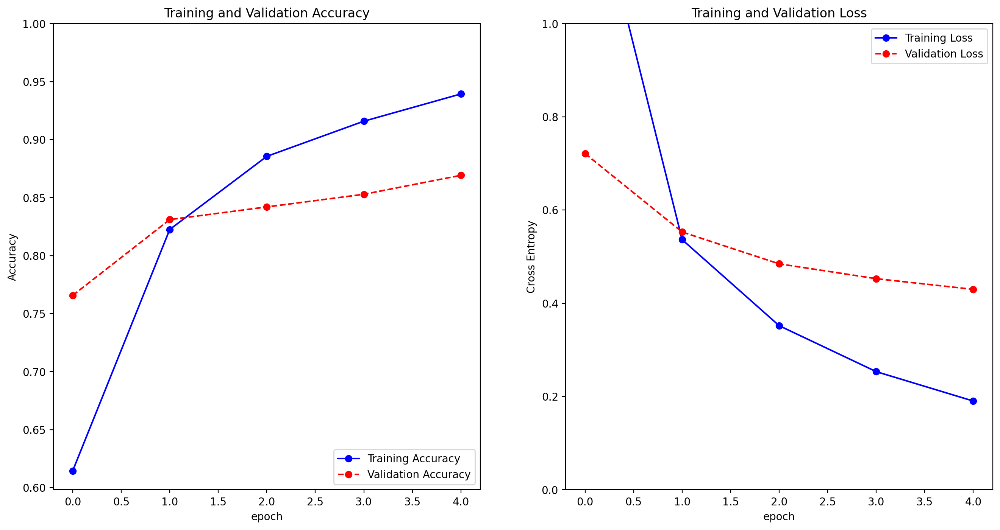

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

# epochs_range = range(len(acc))

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(acc, 'bo-', label='Training Accuracy')     # 대시선
plt.plot(val_acc, 'ro--', label='Validation Accuracy')
# plt.plot(epochs_range, acc, 'bo-', label='Training Accuracy')     # 대시선
# plt.plot(epochs_range, val_acc, 'ro--', label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')
plt.xlabel('epoch')

plt.subplot(1, 2, 2)
plt.plot(loss, 'bo-', label='Training Loss')
plt.plot(val_loss, 'ro--', label='Validation Loss')
# plt.plot(epochs_range, loss, 'bo-', label='Training Loss')
# plt.plot(epochs_range, val_loss, 'ro--', label='Validation Loss')
# plt.plot(val_loss, 'ro:', label='Validation Loss')    # 점선
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## 1.5 모델 평가

In [ ]:
# 테스트 배치 하나(batch_size=32인 경우, 32개의 샘플 이미지)만 가져와서 예측해 보기
# softmax 함수를 통과해서 0~1 사이의 확률값으로 출력됨.
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)

print(f"테스트 배치 #1에 대해 실시한 예측 확률값 리스트: {predictions}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


array([[5.16878362e-09, 3.83459940e-03, 9.61355805e-01, 7.07357685e-06,
        3.48025262e-02],
       [1.00000000e+00, 1.23093127e-08, 3.44244655e-09, 7.70055797e-10,
        2.12684623e-12],
       [7.80549943e-01, 7.95676489e-04, 6.11128286e-03, 2.12521210e-01,
        2.18981495e-05],
       [1.43914588e-06, 2.17638983e-04, 4.19372946e-01, 2.79334035e-05,
        5.80380023e-01],
       [9.90695477e-01, 5.71841793e-03, 3.96938740e-05, 3.26953013e-03,
        2.76951876e-04],
       [9.99891758e-01, 8.11440841e-05, 5.97863391e-06, 1.61884452e-06,
        1.95160574e-05],
       [1.95194874e-03, 1.36268735e-01, 8.52271378e-01, 8.24262947e-03,
        1.26531289e-03],
       [6.15977566e-04, 9.57420230e-01, 8.76442005e-04, 4.10439894e-02,
        4.34046815e-05],
       [2.70678174e-05, 5.32295381e-08, 3.75066179e-07, 9.99972463e-01,
        6.41051514e-08],
       [9.99999881e-01, 4.96279107e-08, 1.86163779e-10, 2.76512981e-08,
        6.91095681e-10],
       [9.95115399e-01, 3.8405

In [ ]:
import numpy as np
predictions = np.argmax(predictions, axis=1)    # 2D 배열의 각 행에 대해 가장 큰 값의 인덱스를 반환
print(f"테스트 배치 #1에 대해서만 실시한 예측 레이블 리스트: {predictions}")

array([2, 0, 0, 4, 0, 0, 2, 1, 3, 0, 0, 0, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       2, 0, 1, 3, 1, 2, 4, 1, 0, 4], dtype=int64)

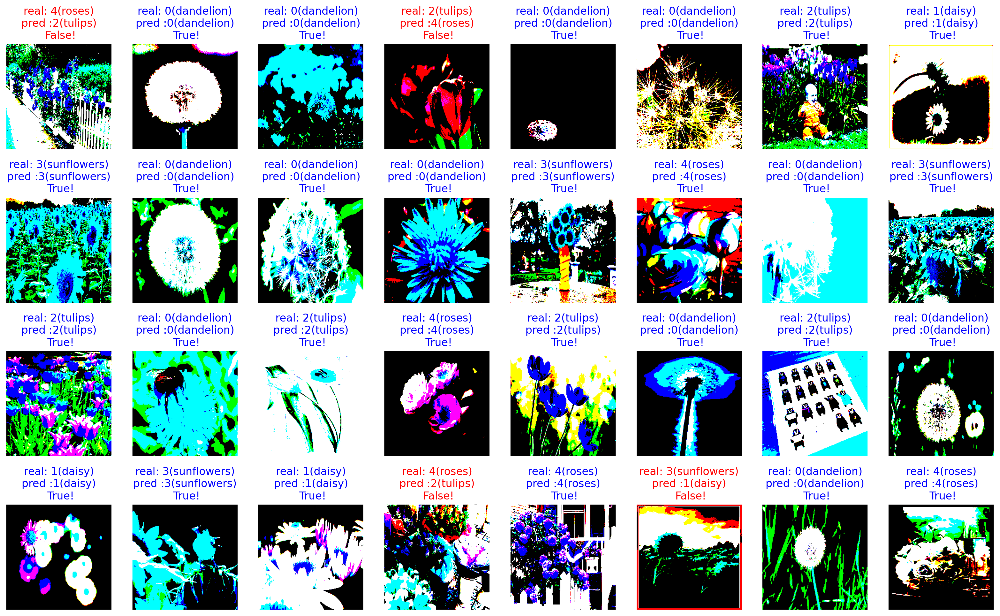

In [ ]:
plt.figure(figsize=(20, 12))

get_label_name = metadata.features['label'].int2str   # int2str: 정수형 레이블을 문자열 레이블로 변환

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    # image = (image + 1) / 2   # -1부터 1까지의 값을 --> 0~1 사이의 값으로 변환
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label}({get_label_name(label)})\npred :{prediction}({get_label_name(prediction)})\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

In [ ]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(f"테스트 배치 #1에 대해서만 실시한 예측 정확도: {count / 32}")

87.5


In [ ]:
# 테스트 데이터셋 전체에 대해 최종 평가 진행
loss, acc = model.evaluate(test_batches)
print(f"전체 테스트 데이터셋에 대해 평가한 최종 정확도: {acc:.3f}")

12/12 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.8451 - loss: 0.4491
테스트 정확도: 0.853


# 2. MobileNet 모델

## 2.1 [공통] MobileNet 모델을 위한 데이터 전처리
- 매번 할 필요 없이 한 번만 진행하면 됨.

## 2.2 MobileNet V1 모델

### 2.2.1 데이터 전처리

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
image batch's shape: (32, 224, 224, 3), label batch's shape: (32,)


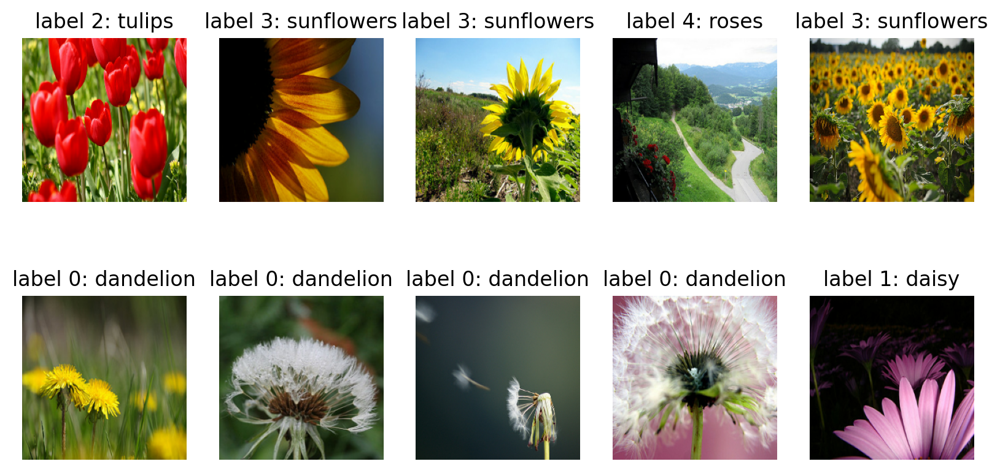

In [ ]:
# MobileNet 모델용 데이터 전처리
# mobilenet, mobilenet_v2, mobilenet_v3 3가지 유형만 가능.
model_name = 'mobilenet'
img_size = 224
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

### 2.2.2 모델 정의, 컴파일, 훈련, 평가

베이스 모델 구조 확인: 


Model: "mobilenet_1.00_224"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_14 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1 (Conv2D)                  │ (None, 112, 112, 32)   │           864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1_bn (BatchNormalization)   │ (None, 112, 112, 32)   │           128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1_relu (ReLU)               │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_1 (DepthwiseConv2D)     │ (None, 112, 112, 32)   │           288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_1_bn                    │ (None, 112, 112, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_1_relu (ReLU)           │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_1 (Conv2D)              │ (None, 112, 112, 64)   │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_1_bn                    │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_1_relu (ReLU)           │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pad_2 (ZeroPadding2D)      │ (None, 113, 113, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_2 (DepthwiseConv2D)     │ (None, 56, 56, 64)     │           576 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_2_bn                    │ (None, 56, 56, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_2_relu (ReLU)           │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_2 (Conv2D)              │ (None, 56, 56, 128)    │         8,192 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_2_bn                    │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_2_relu (ReLU)           │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_3 (DepthwiseConv2D)     │ (None, 56, 56, 128)    │         1,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_3_bn                    │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_dw_3_relu (ReLU)           │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_3 (Conv2D)              │ (None, 56, 56, 128)    │        16,384 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv_pw_3_bn                    │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │             

 Total params: 3,228,864 (12.32 MB)

 Trainable params: 3,206,976 (12.23 MB)

 Non-trainable params: 21,888 (85.50 KB)

전체 모델 구조 확인: 


Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_15 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenet_1.00_224 (Functional) │ (None, 7, 7, 1024)     │     3,228,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_13     │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 1024)           │     1,049,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 5)              │         5,125 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,283,589 (16.34 MB)

 Trainable params: 1,054,725 (4.02 MB)

 Non-trainable params: 3,228,864 (12.32 MB)

20/20 ━━━━━━━━━━━━━━━━━━━━ 4s 131ms/step - accuracy: 0.1940 - loss: 2.0367
훈련 시작 전 초기화 상태에서 검증용 배치 20개에 대해 평가한 초기 손실값: 2.08
훈련 시작 전 초기화 상태에서 검증용 배치 20개에 대해 평가한 초기 정확도: 0.16
훈련 시작...
Epoch 1/20


C:\Users\freen\AppData\Local\Programs\Python\Python311\Lib\contextlib.py:155: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 261ms/step - accuracy: 0.6559 - loss: 0.9235 - val_accuracy: 0.8747 - val_loss: 0.3832
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 24s 261ms/step - accuracy: 0.8925 - loss: 0.3150 - val_accuracy: 0.8747 - val_loss: 0.3221
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 24s 263ms/step - accuracy: 0.9338 - loss: 0.2216 - val_accuracy: 0.8828 - val_loss: 0.2969
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 25s 274ms/step - accuracy: 0.9484 - loss: 0.1649 - val_accuracy: 0.8937 - val_loss: 0.2811
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 297ms/step - accuracy: 0.9692 - loss: 0.1241 - val_accuracy: 0.8965 - val_loss: 0.2697
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 29s 318ms/step - accuracy: 0.9802 - loss: 0.0935 - val_accuracy: 0.9155 - val_loss: 0.2609
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 31s 334ms/step - accuracy: 0.9880 - loss: 0.0699 - val_accuracy: 0.9183 - val_loss: 0.2554
Epoch 8/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 33s 364ms/step - accuracy: 0.9939 - loss: 0.0519 - val_accuracy: 0.918

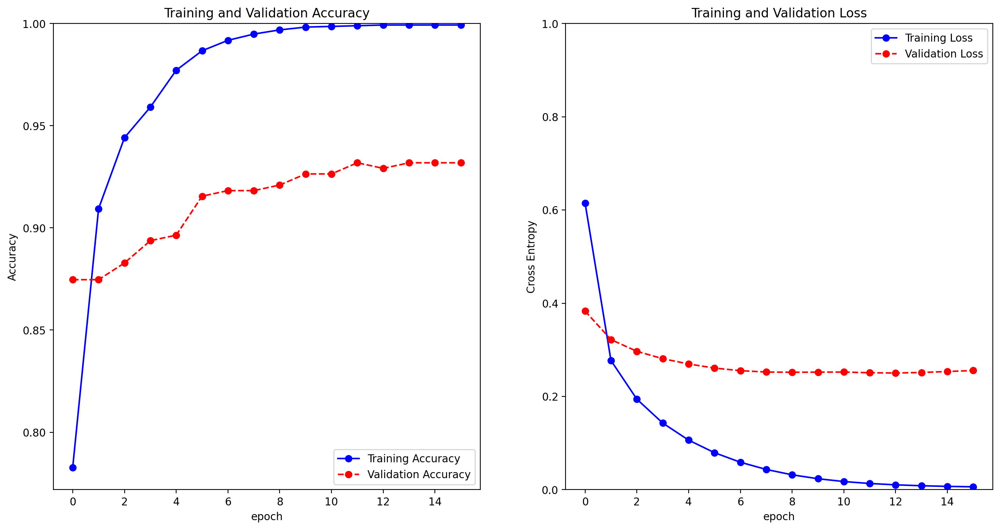

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 837ms/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[3.14335106e-04 3.14508681e-03 9.83924866e-01 5.59949689e-03
  7.01624574e-03]
 [9.99999642e-01 3.84890484e-07 1.96985308e-08 3.56106589e-10
  5.62088420e-09]
 [6.80809915e-01 8.65661514e-06 1.57760428e-06 3.19163591e-01
  1.63062159e-05]
 [1.47035353e-05 2.13759556e-01 7.82343984e-01 1.07114192e-03
  2.81061558e-03]
 [9.99716580e-01 1.08791020e-04 1.92318621e-05 1.53985457e-04
  1.45575984e-06]
 [9.99954462e-01 2.60956422e-05 1.42826602e-05 5.11291819e-06
  2.13032241e-08]
 [4.26851147e-06 1.12749601e-03 9.98766780e-01 9.60292964e-05
  5.54328017e-06]
 [4.71669337e-04 9.99195635e-01 4.05976607e-07 3.31576623e-04
  6.46477929e-07]
 [8.29381406e-06 3.13928410e-07 5.02846706e-06 9.99985814e-01
  5.31354260e-07]
 [9.99999166e-01 7.56054988e-07 2.64844626e-08 1.01116001e-07
  3.75346154e-08]
 [9.99995828e-01 4.01063198e-06 7.57763630e-08 1.38624223e-08
  3.95232735e-09]
 [9.10257995e-01 3.73560414e-02 3.82131897e-02 1.39873698e-02
  1.85474360e-04]
 [2.887581

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.9375
12/12 ━━━━━━━━━━━━━━━━━━━━ 4s 299ms/step - accuracy: 0.9299 - loss: 0.2534
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.940


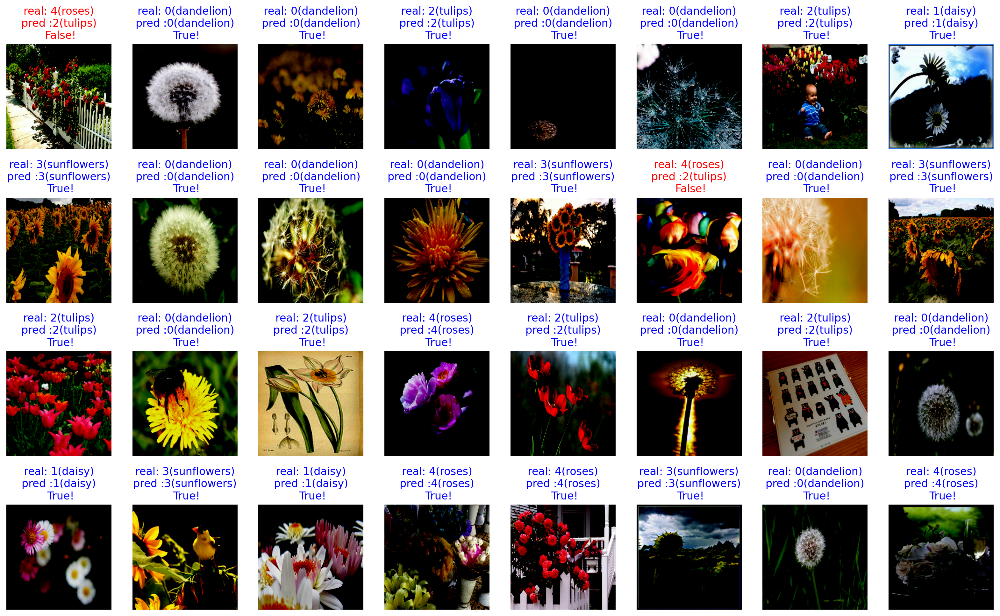

In [ ]:
# MobileNet 모델 훈련 및 평가 실시
full_train_and_evaluate(model_name='mobilenet', img_size=224, num_classes=5, learning_rate=0.0001)

## 2.3 MobileNet V2 모델

### 2.3.1 데이터 전처리

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
image batch's shape: (32, 224, 224, 3), label batch's shape: (32,)


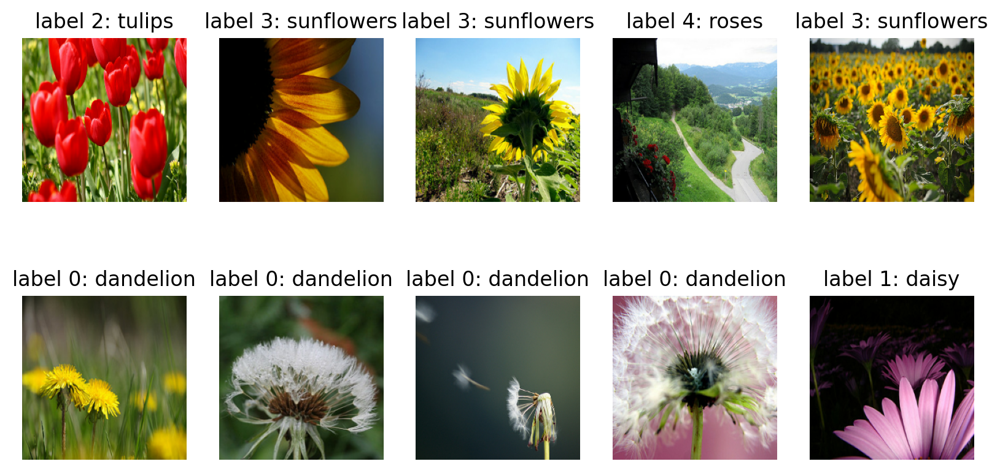

In [ ]:
# MobileNet V2 모델용 데이터 전처리
# mobilenet, mobilenet_v2, mobilenet_v3 3가지 유형만 가능.
model_name = 'mobilenet_v2'
img_size = 224
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

### 2.3.2 모델 정의, 컴파일, 훈련, 평가

베이스 모델 구조 확인: 


Model: "mobilenetv2_1.00_224"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_16      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_16[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,257,984 (8.61 MB)

 Trainable params: 2,223,872 (8.48 MB)

 Non-trainable params: 34,112 (133.25 KB)

전체 모델 구조 확인: 


Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_17 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_14     │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 1280)           │     1,639,680 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 5)              │         6,405 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,904,069 (14.89 MB)

 Trainable params: 1,646,085 (6.28 MB)

 Non-trainable params: 2,257,984 (8.61 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 5s 247ms/step - accuracy: 0.1952 - loss: 1.8198
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 1.82
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.17
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 31s 297ms/step - accuracy: 0.7006 - loss: 0.8455 - val_accuracy: 0.8719 - val_loss: 0.3937
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 288ms/step - accuracy: 0.9050 - loss: 0.2960 - val_accuracy: 0.8828 - val_loss: 0.3335
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 26s 284ms/step - accuracy: 0.9366 - loss: 0.2055 - val_accuracy: 0.8856 - val_loss: 0.3185
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 26s 283ms/step - accuracy: 0.9613 - loss: 0.1518 - val_accuracy: 0.8828 - val_loss: 0.3069
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 298ms/step - accuracy: 0.9722 - loss: 0.1144 - val_accuracy: 0.8856 - val_loss: 0.2947
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 29s 318ms/step - accuracy: 0.9798 - loss: 0.0872 - val_accuracy: 0.9046 - val_loss: 0.2820
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 32

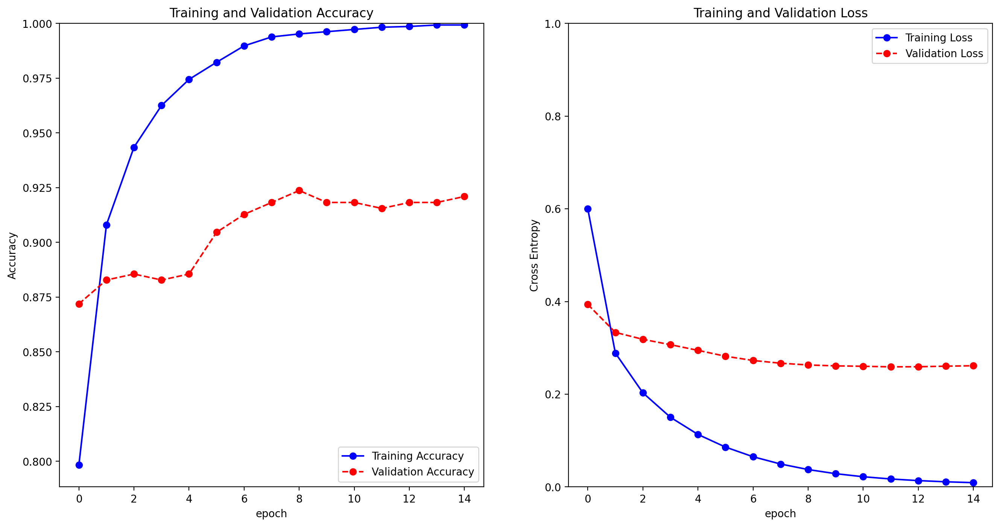

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[3.21269840e-06 1.80992614e-02 2.44742826e-01 1.14373295e-04
  7.37040281e-01]
 [9.99999881e-01 9.29192900e-09 2.90259408e-08 7.48129914e-09
  1.09871060e-07]
 [8.06180656e-01 4.00098143e-05 4.66582242e-06 1.93773821e-01
  7.25043378e-07]
 [7.87639804e-03 2.38880366e-02 8.52830827e-01 2.95334086e-02
  8.58712345e-02]
 [9.99934316e-01 3.75807849e-06 8.03531393e-08 5.98076767e-05
  2.08126698e-06]
 [9.99999762e-01 4.65666297e-08 2.05937710e-07 2.05276507e-09
  1.20205197e-08]
 [1.13255596e-02 1.37492875e-02 9.22070861e-01 1.48807010e-02
  3.79735827e-02]
 [1.05105108e-02 9.41810250e-01 9.82809943e-05 4.74156886e-02
  1.65190722e-04]
 [1.06196199e-02 6.95120605e-07 3.10989970e-04 9.89067614e-01
  1.08309712e-06]
 [1.00000000e+00 8.89395724e-10 4.66362837e-10 1.64053593e-09
  2.08724966e-08]
 [9.98874843e-01 7.64838362e-04 2.41777860e-04 9.72435155e-05
  2.13296262e-05]
 [8.74670863e-01 1.14276633e-02 2.53635901e-03 1.07066445e-01
  4.29871399e-03]
 [4.675092

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.96875
12/12 ━━━━━━━━━━━━━━━━━━━━ 5s 446ms/step - accuracy: 0.9254 - loss: 0.2040
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.916


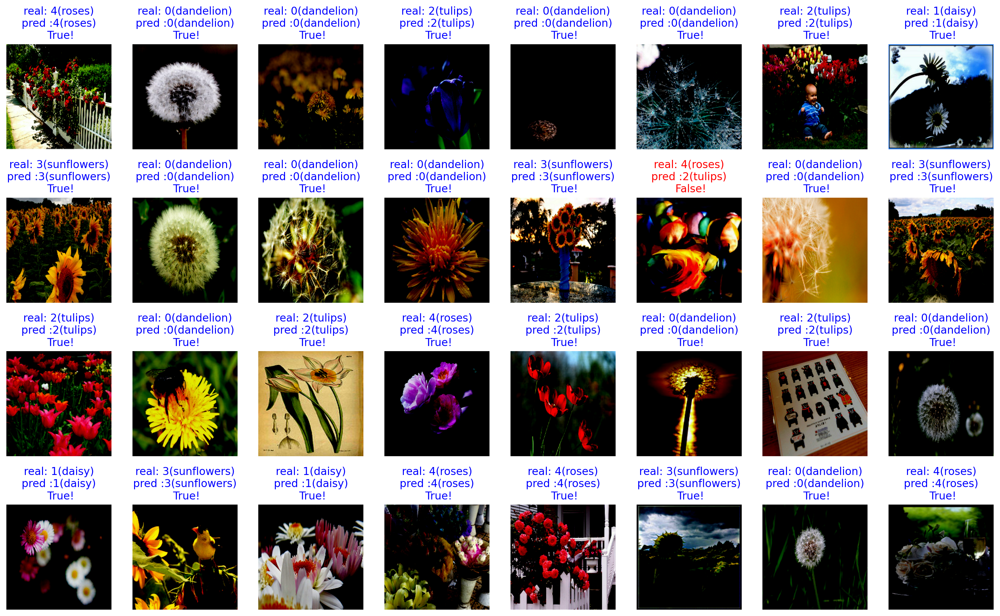

In [ ]:
# MobileNet V2 모델 훈련 및 평가 실시
full_train_and_evaluate(model_name='mobilenet_v2', img_size=224, num_classes=5, learning_rate=0.0001)

## 2.4 MobileNet V3 Large 모델

### 2.4.1 데이터 전처리

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


image batch's shape: (32, 224, 224, 3), label batch's shape: (32,)


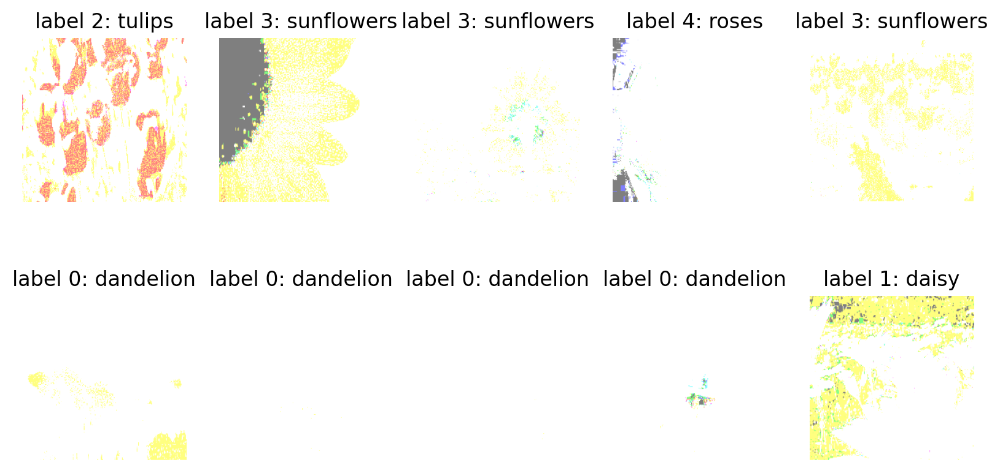

In [ ]:
# MobileNet V3 Large 모델용 데이터 전처리
# mobilenet, mobilenet_v2, mobilenet_v3 3가지 유형만 가능. (데이터 전처리 단계에서는 Large, Small에 따른 구분 없음)
model_name = 'mobilenet_v3'
img_size = 224
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

### 2.4.2 모델 정의, 컴파일, 훈련, 평가

베이스 모델 구조 확인: 


Model: "MobileNetV3Large"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_18      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, 224, 224,  │          0 │ input_layer_18[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling[0][0]   │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        144 │ activation[0][0]  │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        256 │ re_lu[0][0]       │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_add   │ (None, 112, 112,  │          0 │ activation[0][0], │
│ (Add)               │ 16)               │            │ expanded_conv_pr… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │      1,024 │ expanded_conv_ad… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_ex… │ (None, 112, 112,  │        256 │ expanded_conv_1_… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 112, 112,  │          0 │ expanded_conv_1_… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 113, 113,  │          0 │ re_lu_1[0][0]     │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        576 │ expanded_conv_1_… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_1_de… │ (None, 56, 56,    │        256 │ expanded_conv_1_

 Total params: 2,996,352 (11.43 MB)

 Trainable params: 2,971,952 (11.34 MB)

 Non-trainable params: 24,400 (95.31 KB)

전체 모델 구조 확인: 


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_19 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobileNetV3Large (Functional)   │ (None, 7, 7, 960)      │     2,996,352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_15     │ (None, 960)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 960)            │       922,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 5)              │         4,805 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,923,717 (14.97 MB)

 Trainable params: 927,365 (3.54 MB)

 Non-trainable params: 2,996,352 (11.43 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 7s 285ms/step - accuracy: 0.1631 - loss: 1.9254
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 1.95
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.18
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 41s 351ms/step - accuracy: 0.7053 - loss: 0.8234 - val_accuracy: 0.9046 - val_loss: 0.3193
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 29s 316ms/step - accuracy: 0.9266 - loss: 0.2531 - val_accuracy: 0.9101 - val_loss: 0.2577
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 29s 312ms/step - accuracy: 0.9551 - loss: 0.1659 - val_accuracy: 0.9155 - val_loss: 0.2378
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 29s 319ms/step - accuracy: 0.9718 - loss: 0.1207 - val_accuracy: 0.9237 - val_loss: 0.2292
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 29s 312ms/step - accuracy: 0.9805 - loss: 0.0916 - val_accuracy: 0.9292 - val_loss: 0.2256
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 53s 580ms/step - accuracy: 0.9872 - loss: 0.0711 - val_accuracy: 0.9319 - val_loss: 0.2249
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 30

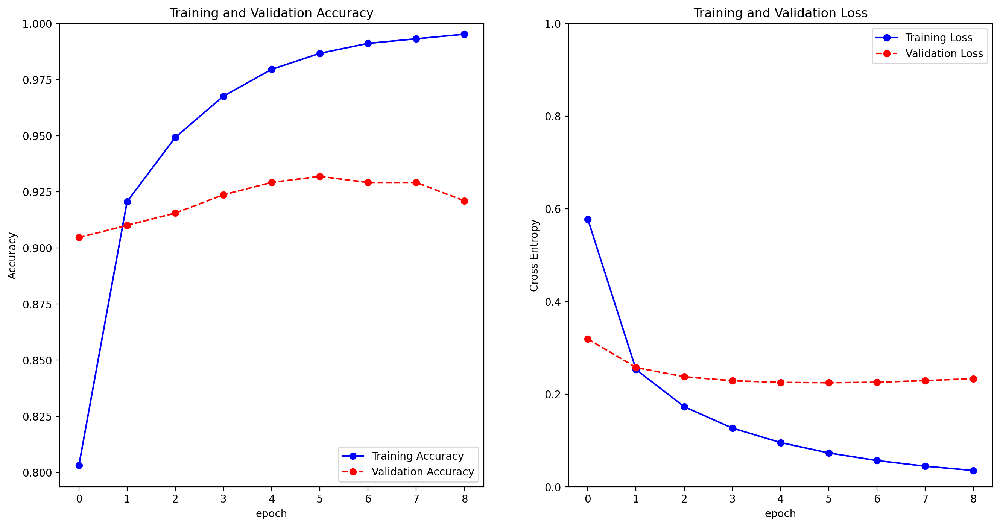

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[1.17489602e-03 7.73060471e-02 7.39568472e-01 8.97127762e-02
  9.22377482e-02]
 [9.99999881e-01 1.10908658e-07 2.29913404e-08 2.14692353e-08
  1.90716563e-08]
 [3.80372465e-01 1.07173948e-03 4.76922514e-03 6.12456024e-01
  1.33054762e-03]
 [4.85172040e-06 1.72493921e-04 9.85920966e-01 5.70010016e-05
  1.38446148e-02]
 [9.96671915e-01 2.39146035e-03 3.62709070e-05 8.70130782e-04
  3.01926575e-05]
 [9.99323964e-01 6.41364546e-04 1.81378746e-05 9.59835415e-06
  7.04862714e-06]
 [3.33478529e-04 5.08134626e-03 9.93975461e-01 3.50849499e-04
  2.58810847e-04]
 [2.17894907e-03 9.92780626e-01 1.24343976e-04 4.88082226e-03
  3.53173455e-05]
 [1.98039878e-03 3.65092819e-05 2.24380114e-04 9.97705400e-01
  5.32906706e-05]
 [9.99995589e-01 1.70886551e-06 1.69959250e-07 2.40326540e-06
  2.69363085e-07]
 [9.82590616e-01 1.24802515e-02 1.92496766e-04 4.61432617e-03
  1.22438476e-04]
 [6.26794875e-01 1.00622093e-02 1.56141922e-01 2.00774014e-01
  6.22698385e-03]
 [2.716539

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.875
12/12 ━━━━━━━━━━━━━━━━━━━━ 4s 311ms/step - accuracy: 0.9204 - loss: 0.2176
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.940


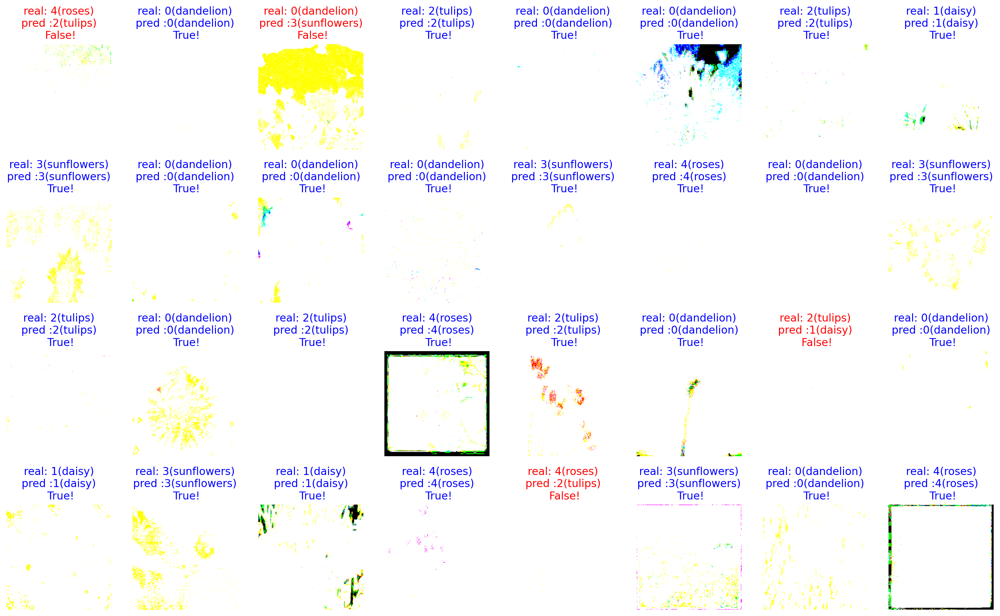

In [ ]:
# MobileNet V3 Large 모델 훈련 및 평가 실시
# 데이터 전처리 단계에서는 Large, Small 구분이 없지만, 모델 단계에서는 구분 있음!
full_train_and_evaluate(model_name='mobilenet_v3_large', img_size=224, num_classes=5, learning_rate=0.0001)

## 2.5 MobileNet V3 Small 모델

### 2.5.1 데이터 전처리

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


image batch's shape: (32, 224, 224, 3), label batch's shape: (32,)


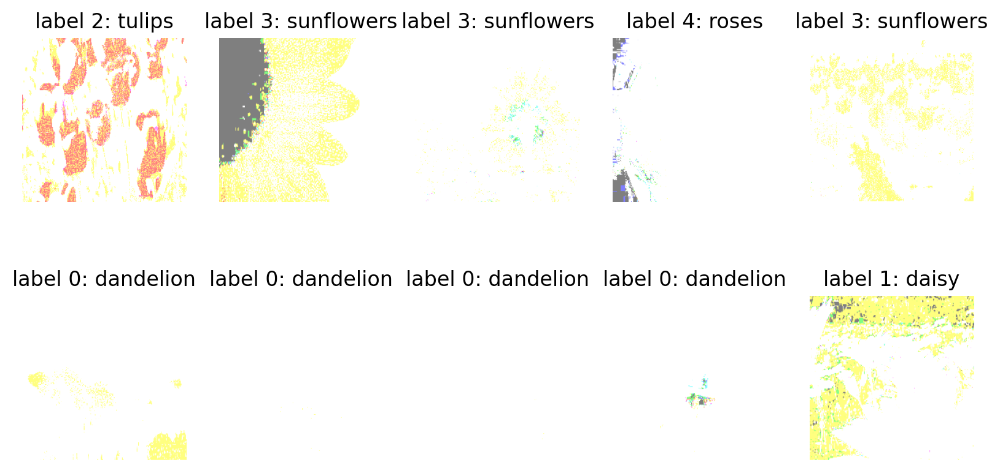

In [ ]:
# MobileNet V3 Small 모델용 데이터 전처리
# mobilenet, mobilenet_v2, mobilenet_v3 3가지 유형만 가능. (데이터 전처리 단계에서는 Large, Small에 따른 구분 없음)
model_name = 'mobilenet_v3'
img_size = 224
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

### 2.5.2 모델 정의, 컴파일, 훈련, 평가

베이스 모델 구조 확인: 


Model: "MobileNetV3Small"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_20      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_1         │ (None, 224, 224,  │          0 │ input_layer_20[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv (Conv2D)       │ (None, 112, 112,  │        432 │ rescaling_1[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv_bn             │ (None, 112, 112,  │         64 │ conv[0][0]        │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_20       │ (None, 112, 112,  │          0 │ conv_bn[0][0]     │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 113, 113,  │          0 │ activation_20[0]… │
│ (ZeroPadding2D)     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 56, 56,    │        144 │ expanded_conv_de… │
│ (DepthwiseConv2D)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 56, 56,    │         64 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_19 (ReLU)     │ (None, 56, 56,    │          0 │ expanded_conv_de… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 16)  │          0 │ re_lu_19[0][0]    │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 8)   │        136 │ expanded_conv_sq… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 8)   │          0 │ expanded_conv_sq… │
│ (ReLU)              │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 1, 1, 16)  │        144 │ expanded_conv_sq… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_8 (Add)         │ (None, 1, 1, 16)  │          0 │ expanded_conv_sq… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_20 (ReLU)     │ (None, 1, 1, 16)  │          0 │ add_8[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_8          │ (None, 1, 1, 16)  │          0 │ re_lu_20[0][0]    │
│ (Multiply)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_sque… │ (None, 56, 56,    │          0 │ re_lu_19[0][0],   │
│ (Multiply)          │ 16)               │            │ multiply_8[0][0]  │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 939,120 (3.58 MB)

 Trainable params: 927,008 (3.54 MB)

 Non-trainable params: 12,112 (47.31 KB)

전체 모델 구조 확인: 


Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_21 (InputLayer)     │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ MobileNetV3Small (Functional)   │ (None, 7, 7, 576)      │       939,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_16     │ (None, 576)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 576)            │       332,352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 5)              │         2,885 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,274,357 (4.86 MB)

 Trainable params: 335,237 (1.28 MB)

 Non-trainable params: 939,120 (3.58 MB)

12/12 ━━━━━━━━━━━━━━━━━━━━ 5s 171ms/step - accuracy: 0.1159 - loss: 1.9101
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 손실값: 1.91
훈련 시작 전 초기화 상태에서 검증용 배치  12 개에 대해 평가한 초기 정확도: 0.14
훈련 시작...
Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 22s 167ms/step - accuracy: 0.5872 - loss: 1.1245 - val_accuracy: 0.8529 - val_loss: 0.5022
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 150ms/step - accuracy: 0.8529 - loss: 0.4766 - val_accuracy: 0.8856 - val_loss: 0.3801
Epoch 3/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 157ms/step - accuracy: 0.8913 - loss: 0.3618 - val_accuracy: 0.8937 - val_loss: 0.3370
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 152ms/step - accuracy: 0.9040 - loss: 0.3069 - val_accuracy: 0.9019 - val_loss: 0.3163
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 15s 159ms/step - accuracy: 0.9202 - loss: 0.2713 - val_accuracy: 0.9128 - val_loss: 0.3045
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14s 157ms/step - accuracy: 0.9249 - loss: 0.2447 - val_accuracy: 0.9074 - val_loss: 0.2974
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 14

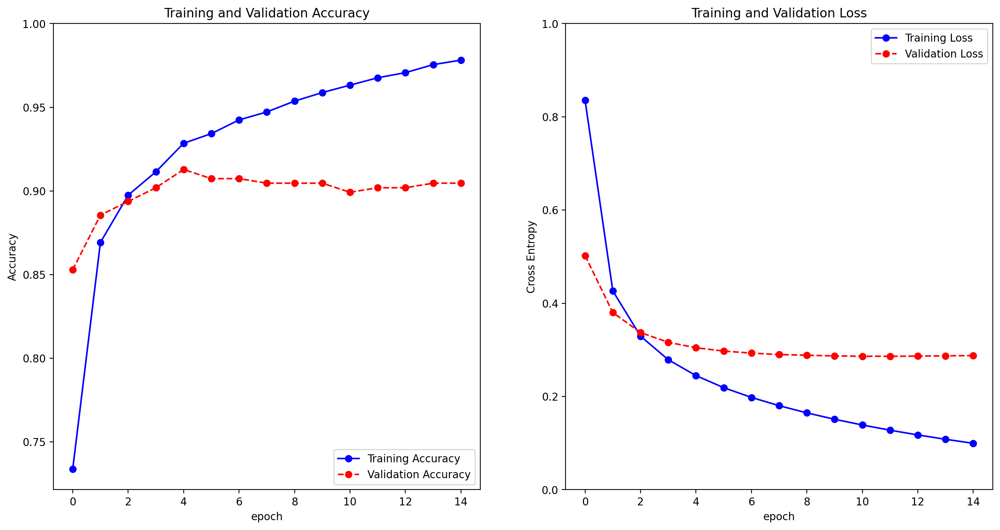

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


테스트 배치 #1에 대해 실시한 예측 확률값 리스트: [[2.53847713e-04 1.64764875e-03 8.75232100e-01 1.54542003e-03
  1.21320985e-01]
 [9.99994159e-01 4.66600341e-06 5.16764032e-07 4.24082401e-07
  1.87189869e-07]
 [5.09141088e-01 1.67775410e-03 3.32304300e-03 4.85612959e-01
  2.45205738e-04]
 [1.25442585e-03 7.38403387e-03 9.36245263e-01 4.83257201e-04
  5.46329953e-02]
 [9.97207820e-01 2.61662947e-03 6.63287137e-05 7.34336863e-05
  3.58004618e-05]
 [9.99879718e-01 5.68714822e-05 4.16377625e-05 1.55816870e-05
  6.18200465e-06]
 [2.17246101e-03 7.37512717e-03 9.46099997e-01 2.77026445e-02
  1.66496988e-02]
 [1.14965618e-01 7.50433147e-01 1.75748859e-02 9.25550386e-02
  2.44713333e-02]
 [8.71831799e-05 5.39474172e-07 4.07513522e-04 9.99490619e-01
  1.40702086e-05]
 [9.99982357e-01 1.69014675e-05 2.56086366e-07 2.79929907e-07
  2.22619903e-07]
 [9.98985469e-01 3.56734672e-04 3.58796329e-04 7.85961092e-05
  2.20272079e-04]
 [5.79656422e-01 5.10167389e-04 2.74732281e-02 3.91784728e-01
  5.75497397e-04]
 [6.044376

테스트 배치 #1에 대해서만 실시한 예측 정확도: 0.90625
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 122ms/step - accuracy: 0.8912 - loss: 0.3182
전체 테스트 데이터셋에 대해 평가한 최종 정확도: 0.899


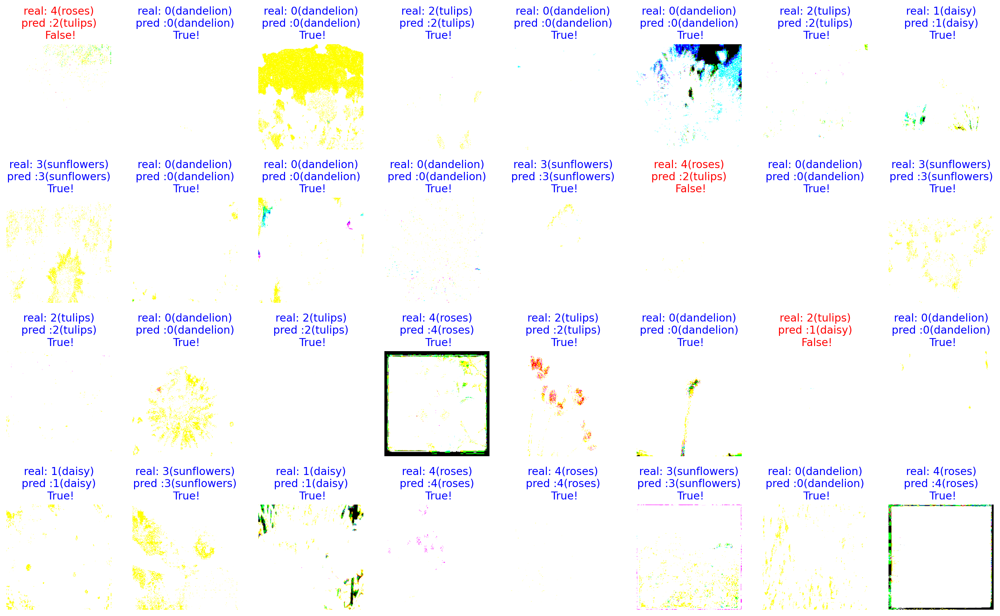

In [ ]:
# MobileNet V3 Small 모델 훈련 및 평가 실시
# 데이터 전처리 단계에서는 Large, Small 구분이 없지만, 모델 단계에서는 구분 있음!
full_train_and_evaluate(model_name='mobilenet_v3_small', img_size=224, num_classes=5, learning_rate=0.0001)

## 2.6 EfficientNetV2L 모델

### 2.6.1 데이터 전처리

<_MapDataset element_spec=(TensorSpec(shape=(480, 480, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(480, 480, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(480, 480, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


image batch's shape: (32, 480, 480, 3), label batch's shape: (32,)


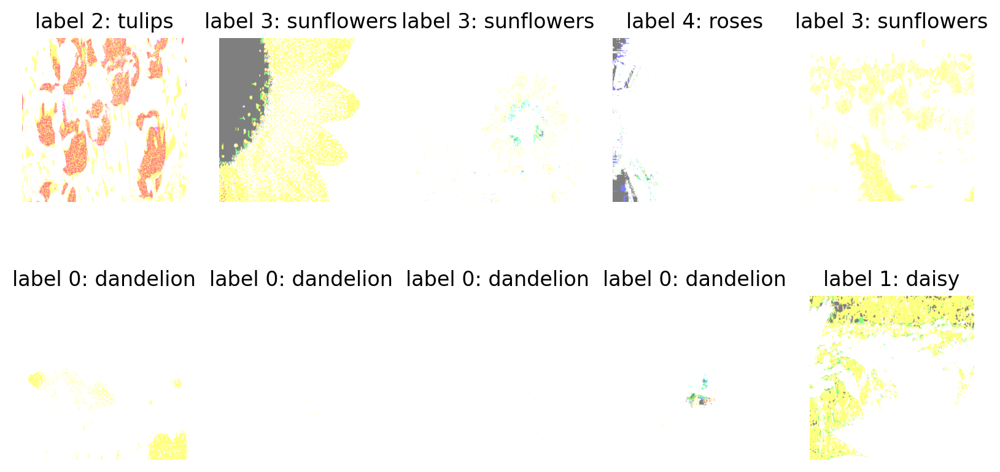

In [13]:
# EfficientNetV2L 모델용 데이터 전처리
# L 모델 외에 M, S 모델도 있긴 함.
model_name = 'efficientnet_v2'
img_size = 480    # EfficientNetV2L 모델의 입력 이미지 크기(L:480, M:448, S:384)
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

### 2.6.2 모델 정의, 컴파일, 훈련, 평가

In [ ]:
# EfficientNetV2L 모델 훈련 및 평가 실시
# L 모델 외에 M, S 모델도 있긴 함.
full_train_and_evaluate(model_name='efficientnet_v2_l', img_size=480, num_classes=5, learning_rate=0.0001)

## 2.7 EfficientNetV2S 모델

### 2.7.1 데이터 전처리

<_MapDataset element_spec=(TensorSpec(shape=(384, 384, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(384, 384, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(384, 384, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


image batch's shape: (32, 384, 384, 3), label batch's shape: (32,)


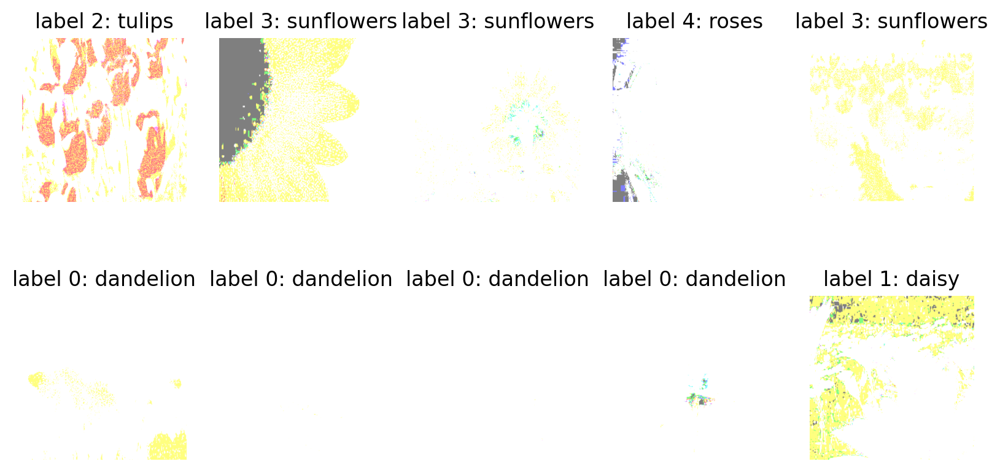

In [11]:
# EfficientNetV2S 모델용 데이터 전처리
# S 모델 외에 M, L 모델도 있긴 함.
model_name = 'efficientnet_v2'
img_size = 384    # EfficientNetV2L 모델의 입력 이미지 크기(L:480, M:448, S:384)
batch_size = 32

train_batches, validation_batches, test_batches = full_preprocess_data(model_name, img_size, batch_size)

### 2.7.2 모델 정의, 컴파일, 훈련, 평가

In [ ]:
# EfficientNetV2S 모델 훈련 및 평가 실시
# S 모델 외에 M, L 모델도 있긴 함.
full_train_and_evaluate(model_name='efficientnet_v2_s', img_size=384, num_classes=5, learning_rate=0.0001)